<a href="https://colab.research.google.com/github/MiqueiasFernandes/bioinformatics/blob/master/sCell_Novas_Analises.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install scanpy leidenalg celltypist scarches adjustText sc_toolbox \
     liana decoupler anndata2ri==1.1 rpy2==3.5.1 scvelo cassiopeia --quiet


<br>

# SINGLE CELL: **Agrupamento e Anotação**
<br>

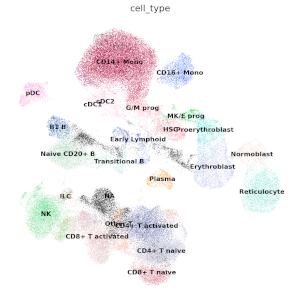

**Referencia: ** https://www.sc-best-practices.org/cellular_structure/clustering.html

<br>
<br>
<br>
<br>

In [ ]:
import scanpy as sc

sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=80,
    facecolor="white",
    frameon=False,
)

In [ ]:
adata = sc.read(
    filename="s4d8_feature_selection.h5ad",
    backup_url="https://figshare.com/ndownloader/files/40016014",
)

  0%|          | 0.00/4.18G [00:00<?, ?B/s]

In [ ]:
adata.X = adata.layers["log1p_norm"]

In [ ]:
# setting highly variable as highly deviant to use scanpy 'use_highly_variable' argument in sc.pp.pca
adata.var["highly_variable"] = adata.var["highly_deviant"]
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)

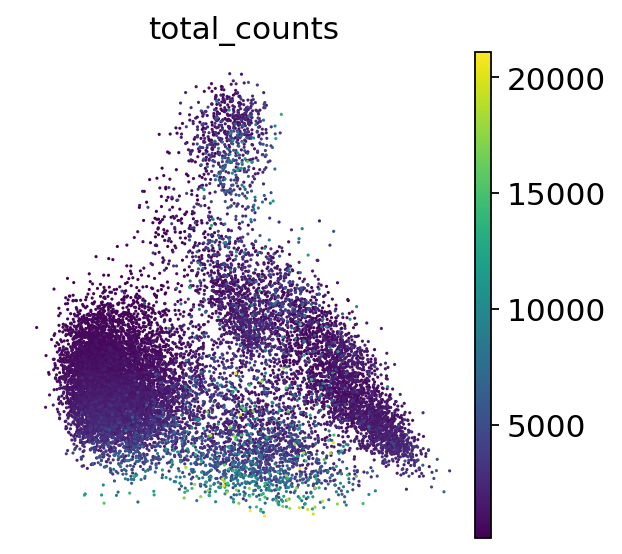

In [ ]:
sc.pl.pca_scatter(adata, color="total_counts")

In [ ]:
sc.tl.tsne(adata, use_rep="X_pca")

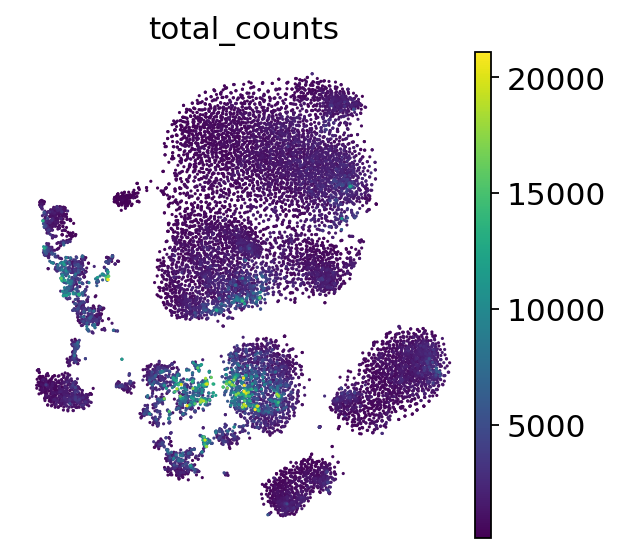

In [ ]:
sc.pl.tsne(adata, color="total_counts")

In [ ]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)

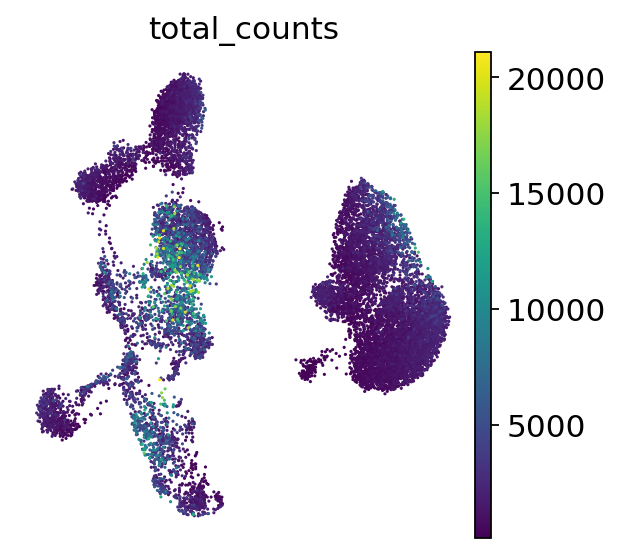

In [ ]:
sc.pl.umap(adata, color="total_counts")

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


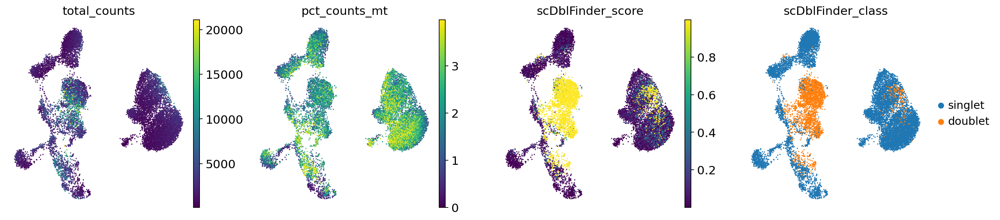

In [ ]:
sc.pl.umap(
    adata,
    color=["total_counts", "pct_counts_mt", "scDblFinder_score", "scDblFinder_class"],
)

In [ ]:
sc.pp.neighbors(adata, n_pcs=30)
sc.tl.umap(adata)

In [ ]:
!pip install leidenalg --quiet

In [ ]:
sc.tl.leiden(adata)

In [ ]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


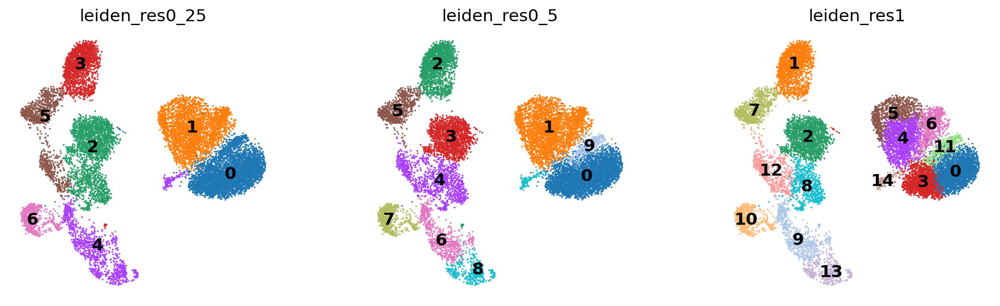

In [ ]:
sc.pl.umap(
    adata,
    color=["leiden_res0_25", "leiden_res0_5", "leiden_res1"],
    legend_loc="on data",
)

In [ ]:
import warnings

warnings.filterwarnings("ignore", category=DeprecationWarning)

import numba
from numba.core.errors import NumbaDeprecationWarning, NumbaPendingDeprecationWarning

warnings.simplefilter("ignore", category=NumbaDeprecationWarning)

In [ ]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
from scipy.sparse import csr_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import celltypist
from celltypist import models
import scarches as sca
import urllib.request

 captum (see https://github.com/pytorch/captum).


In [ ]:
warnings.filterwarnings("ignore", category=pd.errors.PerformanceWarning)

In [ ]:
sc.set_figure_params(figsize=(5, 5))

In [ ]:
adata = sc.read(
    filename="s4d8_clustered.h5ad",
    backup_url="https://figshare.com/ndownloader/files/41436666",
)

  0%|          | 0.00/2.23G [00:00<?, ?B/s]

In [ ]:
marker_genes = {
    "CD14+ Mono": ["FCN1", "CD14"],
    "CD16+ Mono": ["TCF7L2", "FCGR3A", "LYN"],
    "ID2-hi myeloid prog": [
        "CD14",
        "ID2",
        "VCAN",
        "S100A9",
        "CLEC12A",
        "KLF4",
        "PLAUR",
    ],
    "cDC1": ["CLEC9A", "CADM1"],
    "cDC2": [
        "CST3",
        "COTL1",
        "LYZ",
        "DMXL2",
        "CLEC10A",
        "FCER1A",
    ],  # Note: DMXL2 should be negative
    "Normoblast": ["SLC4A1", "SLC25A37", "HBB", "HBA2", "HBA1", "TFRC"],
    "Erythroblast": ["MKI67", "HBA1", "HBB"],
    "Proerythroblast": [
        "CDK6",
        "SYNGR1",
        "HBM",
        "GYPA",
    ],  # Note HBM and GYPA are negative markers
    "NK": ["GNLY", "NKG7", "CD247", "GRIK4", "FCER1G", "TYROBP", "KLRG1", "FCGR3A"],
    "ILC": ["ID2", "PLCG2", "GNLY", "SYNE1"],
    "Lymph prog": [
        "VPREB1",
        "MME",
        "EBF1",
        "SSBP2",
        "BACH2",
        "CD79B",
        "IGHM",
        "PAX5",
        "PRKCE",
        "DNTT",
        "IGLL1",
    ],
    "Naive CD20+ B": ["MS4A1", "IL4R", "IGHD", "FCRL1", "IGHM"],
    "B1 B": [
        "MS4A1",
        "SSPN",
        "ITGB1",
        "EPHA4",
        "COL4A4",
        "PRDM1",
        "IRF4",
        "CD38",
        "XBP1",
        "PAX5",
        "BCL11A",
        "BLK",
        "IGHD",
        "IGHM",
        "ZNF215",
    ],  # Note IGHD and IGHM are negative markers
    "Transitional B": ["MME", "CD38", "CD24", "ACSM3", "MSI2"],
    "Plasma cells": ["MZB1", "HSP90B1", "FNDC3B", "PRDM1", "IGKC", "JCHAIN"],
    "Plasmablast": ["XBP1", "RF4", "PRDM1", "PAX5"],  # Note PAX5 is a negative marker
    "CD4+ T activated": ["CD4", "IL7R", "TRBC2", "ITGB1"],
    "CD4+ T naive": ["CD4", "IL7R", "TRBC2", "CCR7"],
    "CD8+ T": ["CD8A", "CD8B", "GZMK", "GZMA", "CCL5", "GZMB", "GZMH", "GZMA"],
    "T activation": ["CD69", "CD38"],  # CD69 much better marker!
    "T naive": ["LEF1", "CCR7", "TCF7"],
    "pDC": ["GZMB", "IL3RA", "COBLL1", "TCF4"],
    "G/M prog": ["MPO", "BCL2", "KCNQ5", "CSF3R"],
    "HSC": ["NRIP1", "MECOM", "PROM1", "NKAIN2", "CD34"],
    "MK/E prog": [
        "ZNF385D",
        "ITGA2B",
        "RYR3",
        "PLCB1",
    ],  # Note PLCB1 is a negative marker
}

In [ ]:
marker_genes_in_data = dict()
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

In [ ]:
adata.layers["counts"] = adata.X
adata.X = adata.layers["scran_normalization"]

In [ ]:
adata.var["highly_variable"] = adata.var["highly_deviant"]

In [ ]:
sc.tl.pca(adata, n_comps=50, use_highly_variable=True)

In [ ]:
sc.pp.neighbors(adata)

In [ ]:
sc.tl.umap(adata)

In [ ]:
B_plasma_cts = [
    "Naive CD20+ B",
    "B1 B",
    "Transitional B",
    "Plasma cells",
    "Plasmablast",
]

NAIVE CD20+ B:


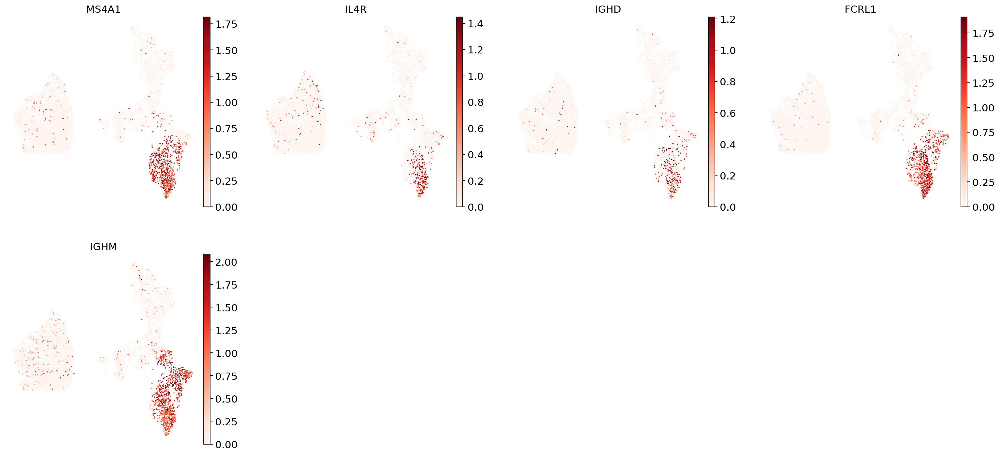





B1 B:


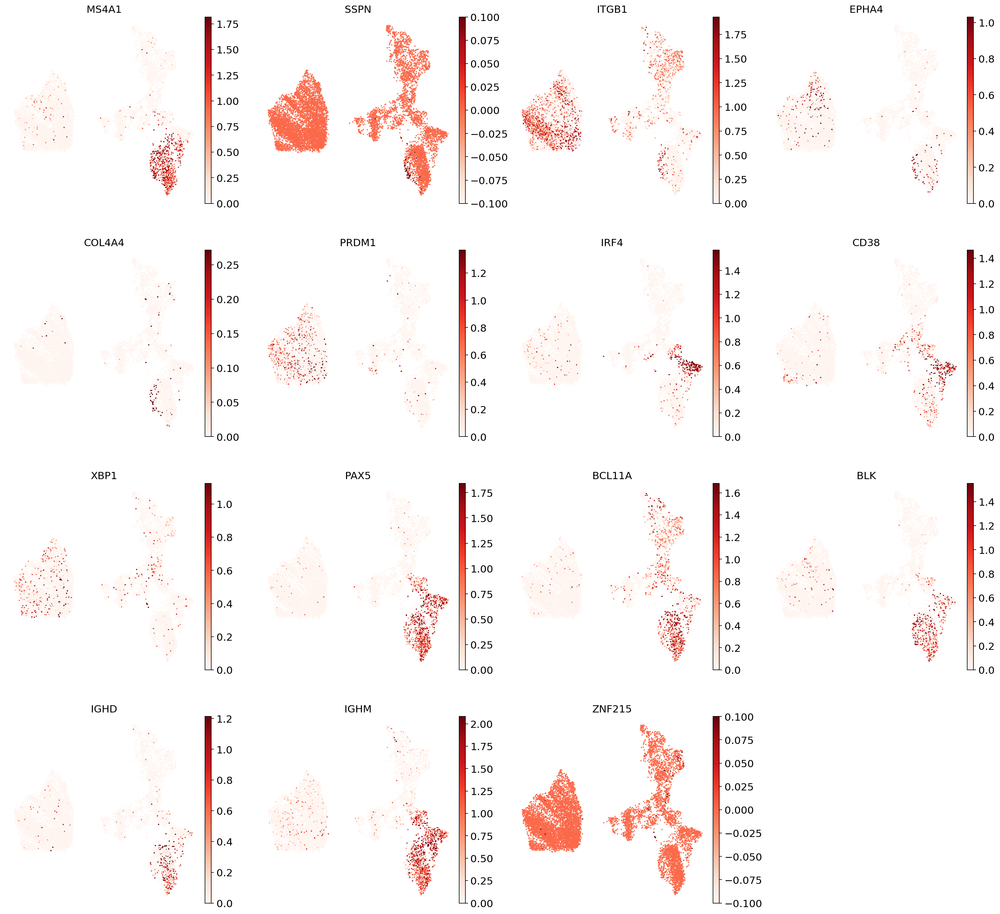





TRANSITIONAL B:


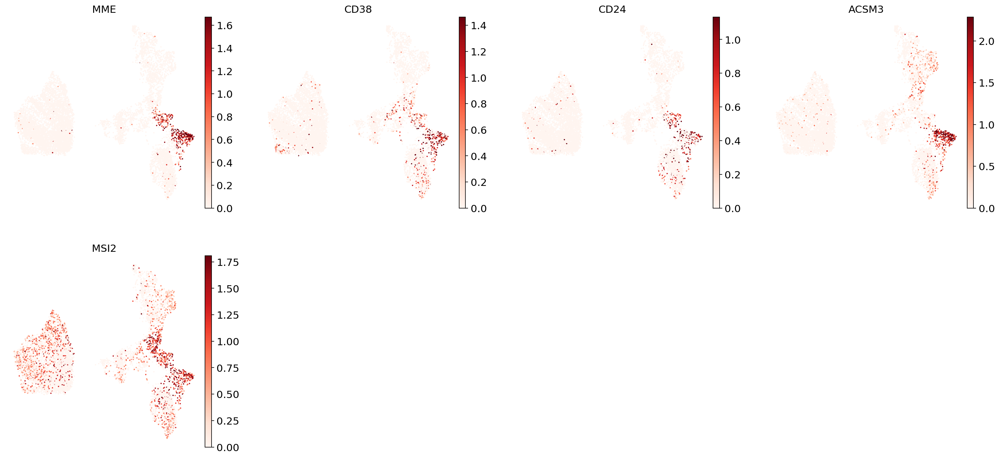





PLASMA CELLS:


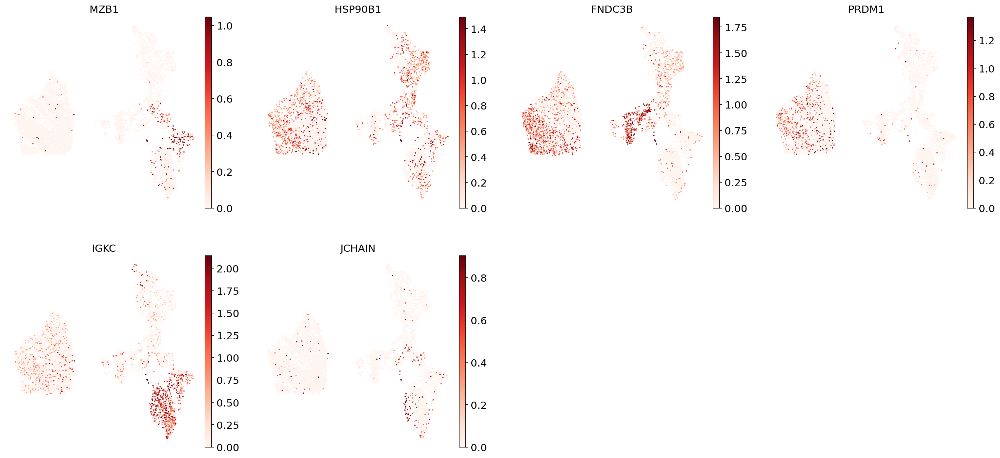





PLASMABLAST:


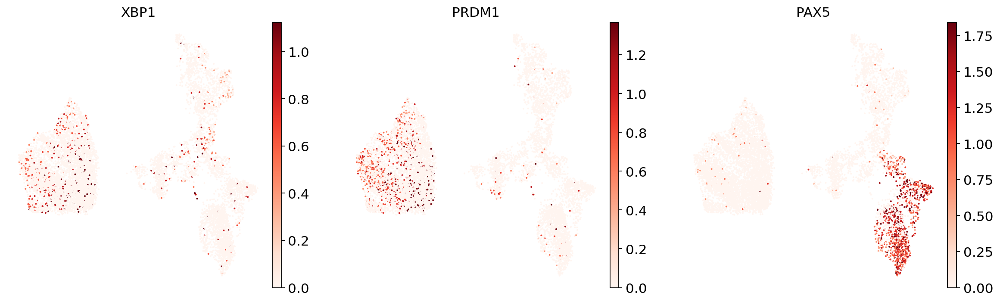

In [ ]:
for ct in B_plasma_cts:
    print(f"{ct.upper()}:")  # print cell subtype name
    sc.pl.umap(
        adata,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    )
    print("\n\n\n")  # print white space for legibility



In [ ]:
sc.tl.leiden(adata, resolution=1, key_added="leiden_1")

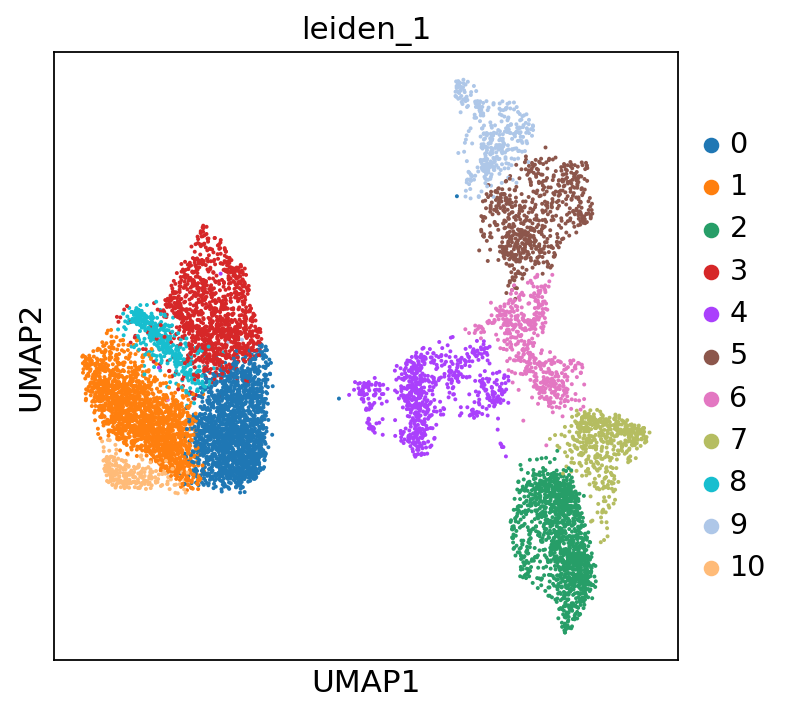

In [ ]:
sc.pl.umap(adata, color="leiden_1")

In [ ]:
sc.tl.leiden(adata, resolution=2, key_added="leiden_2")

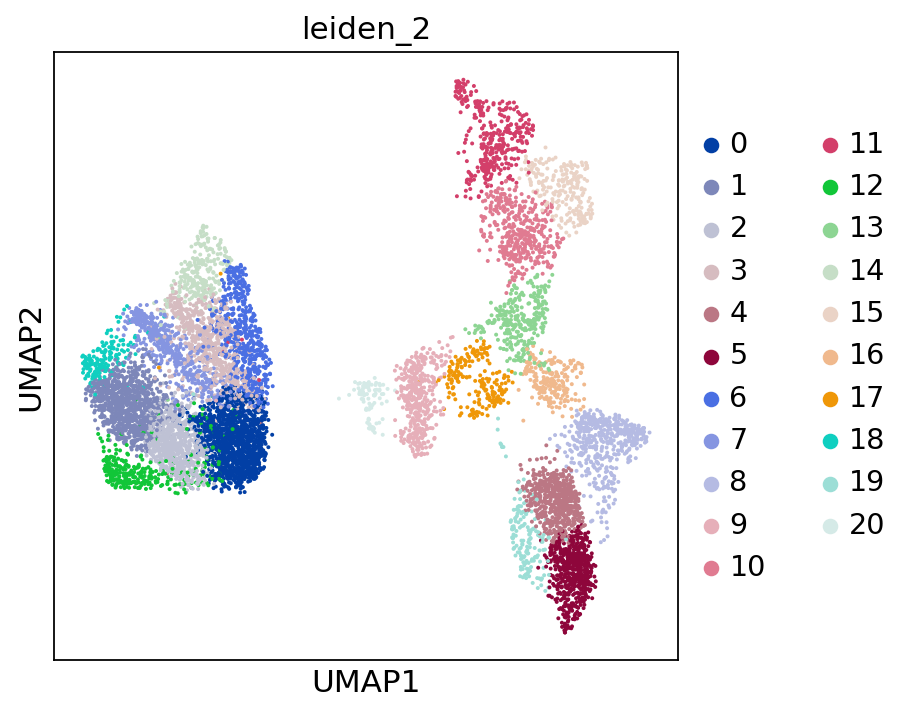

In [ ]:
sc.pl.umap(adata, color="leiden_2")

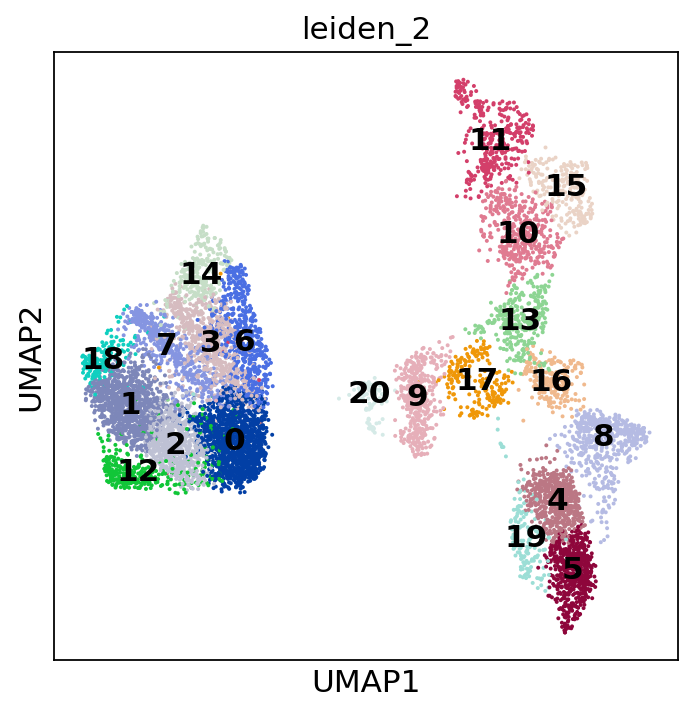

In [ ]:
sc.pl.umap(adata, color="leiden_2", legend_loc="on data")

In [ ]:
B_plasma_markers = {
    ct: [m for m in ct_markers if m in adata.var.index]
    for ct, ct_markers in marker_genes.items()
    if ct in B_plasma_cts
}

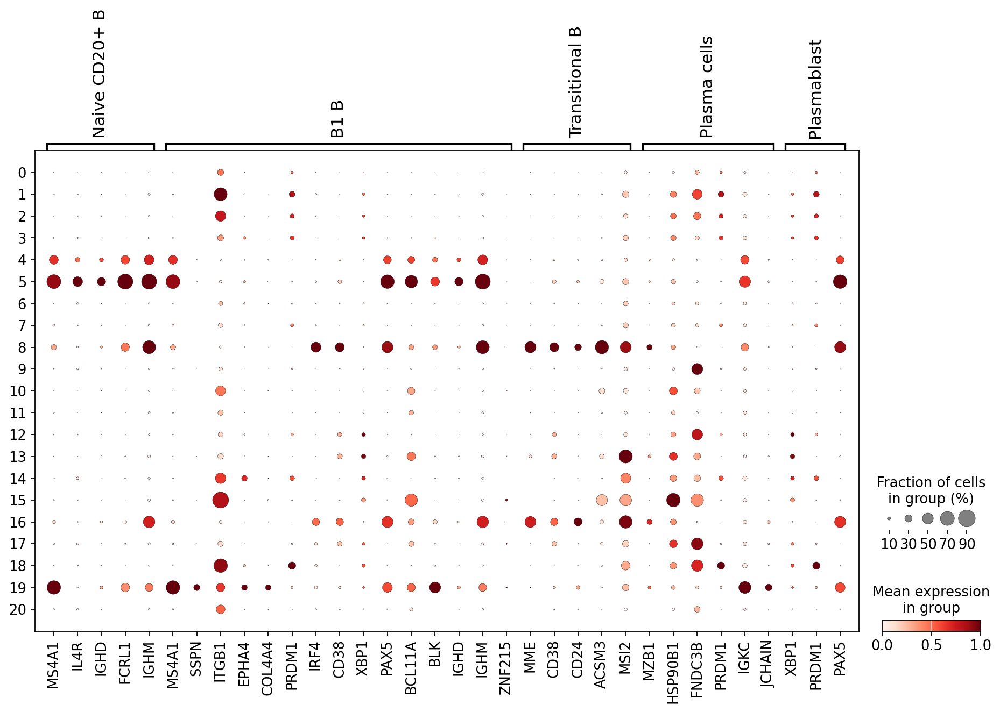

In [ ]:
sc.pl.dotplot(
    adata,
    groupby="leiden_2",
    var_names=B_plasma_markers,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
)

In [ ]:
cl_annotation = {
    "4": "Naive CD20+ B",
    "6": "Naive CD20+ B",
    "8": "Transitional B",
    "18": "B1 B",  # note that IGHD and IGHM are negative markers, in this case more lowly expressed than in the other B cell clusters
}

In [ ]:
adata.obs["manual_celltype_annotation"] = adata.obs.leiden_2.map(cl_annotation)

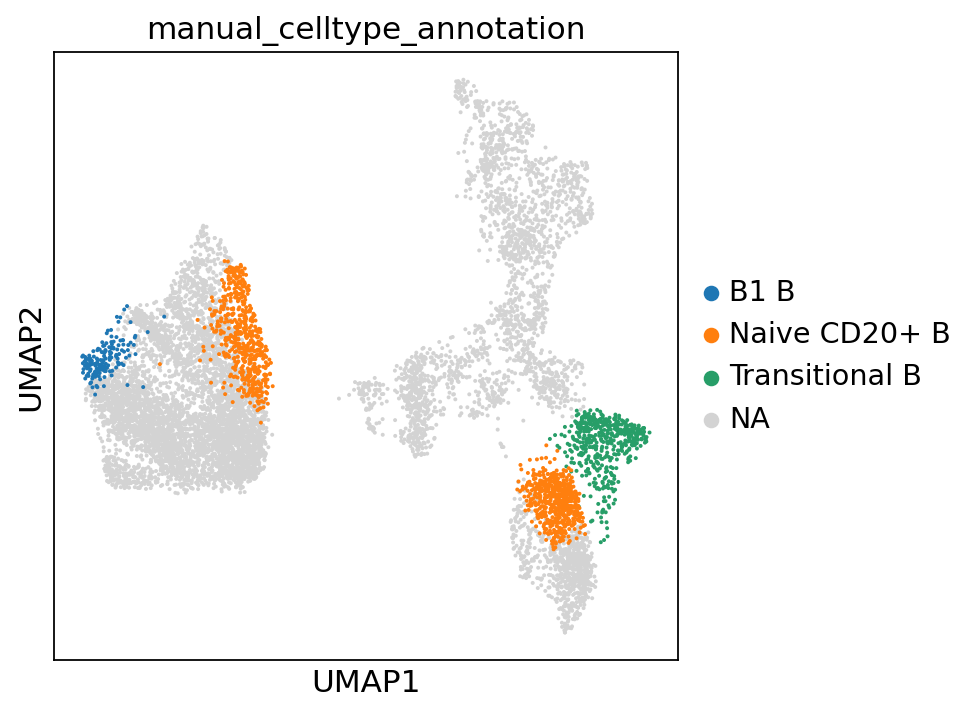

In [ ]:
sc.pl.umap(adata, color=["manual_celltype_annotation"])

In [ ]:
sc.tl.rank_genes_groups(
    adata, groupby="leiden_2", method="wilcoxon", key_added="dea_leiden_2"
)

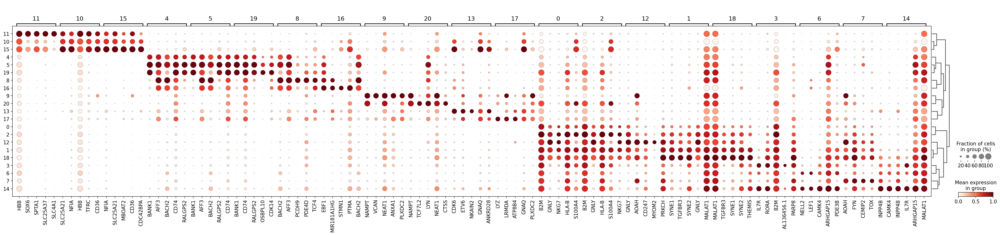

In [ ]:
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="leiden_2", standard_scale="var", n_genes=5, key="dea_leiden_2"
)

In [ ]:
sc.tl.filter_rank_genes_groups(
    adata,
    min_in_group_fraction=0.2,
    max_out_group_fraction=0.2,
    key="dea_leiden_2",
    key_added="dea_leiden_2_filtered",
)

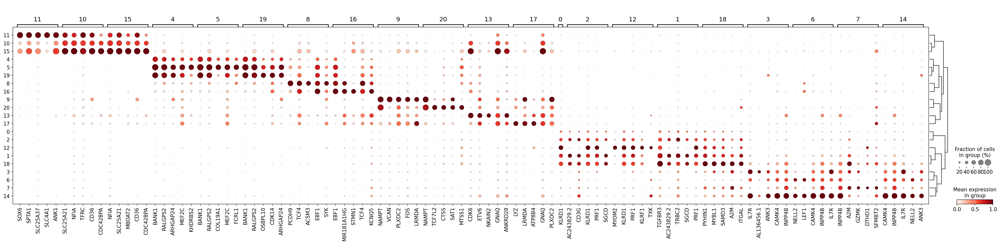

In [ ]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    groupby="leiden_2",
    standard_scale="var",
    n_genes=5,
    key="dea_leiden_2_filtered",
)

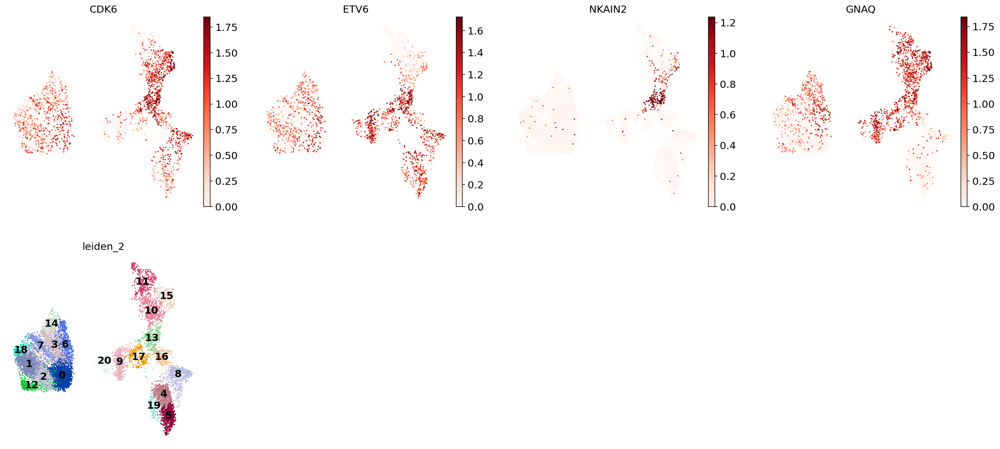

In [ ]:
sc.pl.umap(
    adata,
    color=["CDK6", "ETV6", "NKAIN2", "GNAQ", "leiden_2"],
    vmax="p99",
    legend_loc="on data",
    frameon=False,
    cmap="Reds",
)

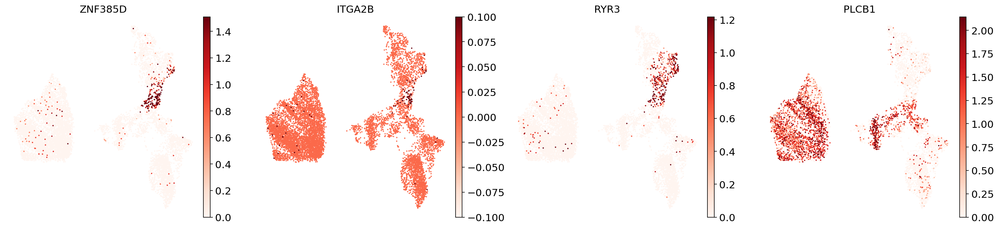

In [ ]:
sc.pl.umap(
    adata,
    color=[
        "ZNF385D",
        "ITGA2B",
        "RYR3",
        "PLCB1",
    ],
    vmax="p99",
    legend_loc="on data",
    frameon=False,
    cmap="Reds",
)

In [ ]:
cl_annotation["12"] = "HSCs + MK/E prog (?)"
adata.obs["manual_celltype_annotation"] = adata.obs.leiden_2.map(cl_annotation)

In [ ]:
adata_celltypist = adata.copy()  # make a copy of our adata
adata_celltypist.X = adata.layers["counts"]  # set adata.X to raw counts
sc.pp.normalize_per_cell(
    adata_celltypist, counts_per_cell_after=10**4
)  # normalize to 10,000 counts per cell
sc.pp.log1p(adata_celltypist)  # log-transform
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [ ]:
models.download_models(
    force_update=True, model=["Immune_All_Low.pkl", "Immune_All_High.pkl"]
)

In [ ]:
model_low = models.Model.load(model="Immune_All_Low.pkl")
model_high = models.Model.load(model="Immune_All_High.pkl")

In [ ]:
predictions_high = celltypist.annotate(
    adata_celltypist, model=model_high, majority_voting=True
)

In [ ]:
predictions_high_adata = predictions_high.to_adata()

In [ ]:
adata.obs["celltypist_cell_label_coarse"] = predictions_high_adata.obs.loc[
    adata.obs.index, "majority_voting"
]
adata.obs["celltypist_conf_score_coarse"] = predictions_high_adata.obs.loc[
    adata.obs.index, "conf_score"
]

In [ ]:
predictions_low = celltypist.annotate(
    adata_celltypist, model=model_low, majority_voting=True
)

In [ ]:
predictions_low_adata = predictions_low.to_adata()

In [ ]:
adata.obs["celltypist_cell_label_fine"] = predictions_low_adata.obs.loc[
    adata.obs.index, "majority_voting"
]
adata.obs["celltypist_conf_score_fine"] = predictions_low_adata.obs.loc[
    adata.obs.index, "conf_score"
]

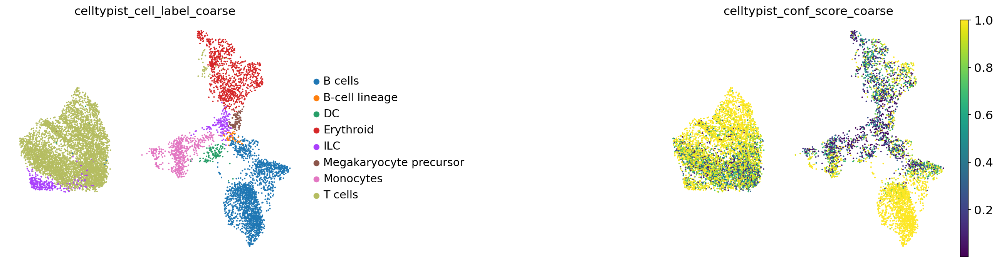

In [ ]:
sc.pl.umap(
    adata,
    color=["celltypist_cell_label_coarse", "celltypist_conf_score_coarse"],
    frameon=False,
    sort_order=False,
    wspace=1,
)

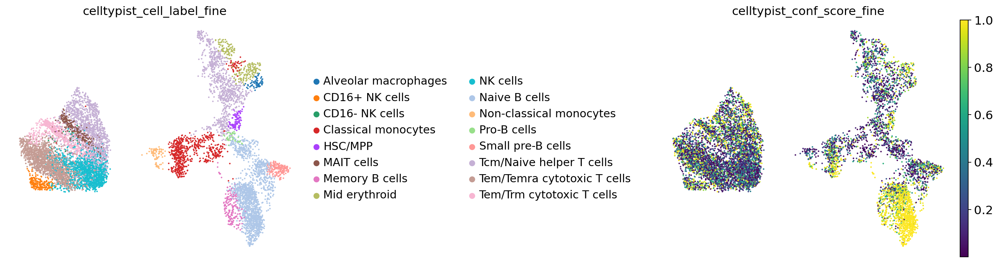

In [ ]:
sc.pl.umap(
    adata,
    color=["celltypist_cell_label_fine", "celltypist_conf_score_fine"],
    frameon=False,
    sort_order=False,
    wspace=1,
)

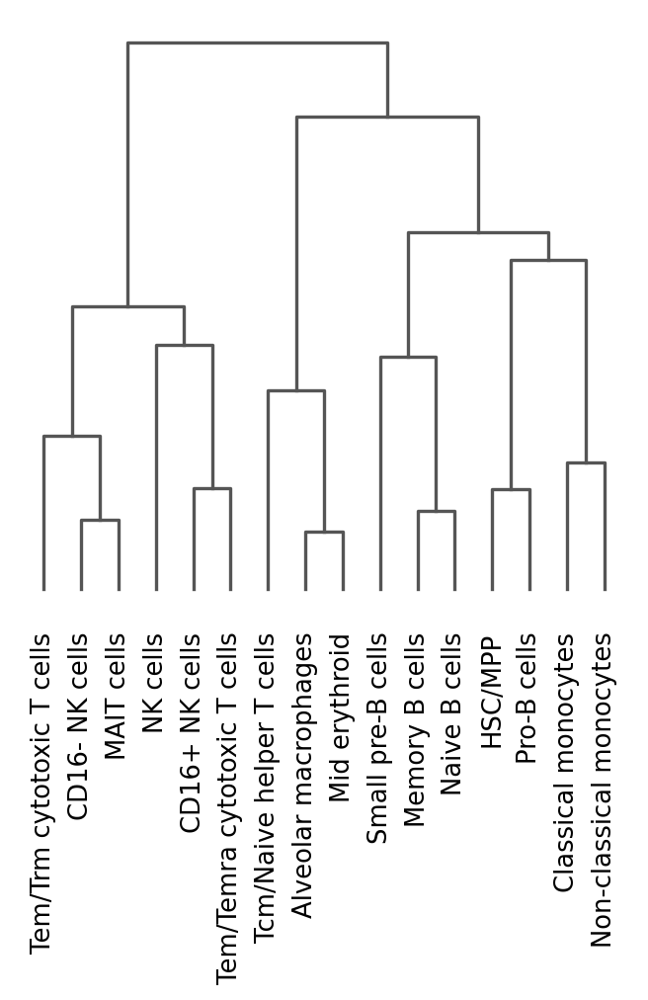

<Axes: >

In [ ]:
sc.pl.dendrogram(adata, groupby="celltypist_cell_label_fine")

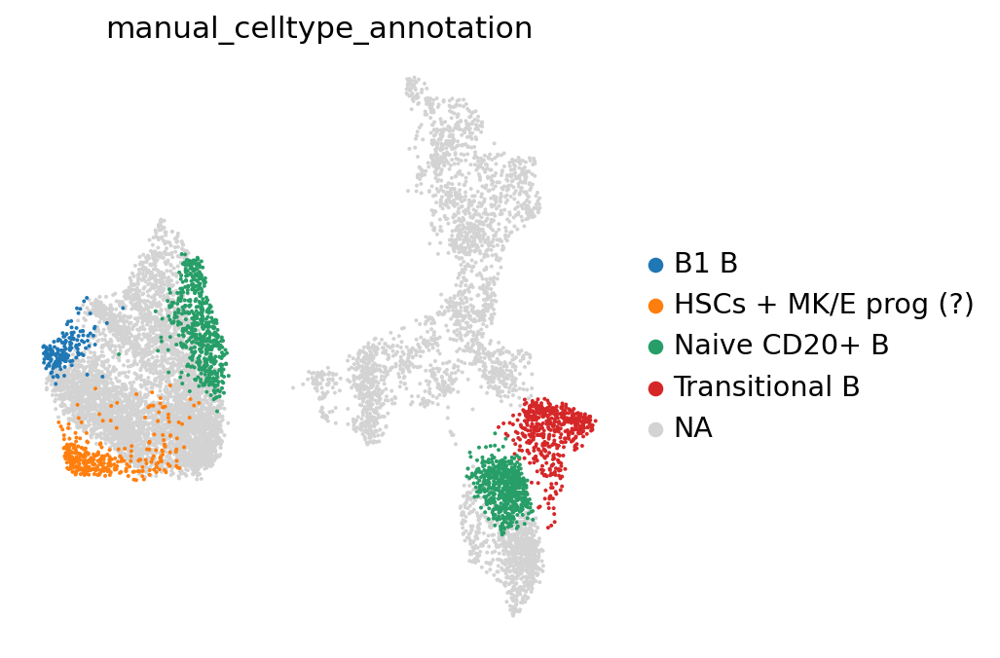

In [ ]:
sc.pl.umap(
    adata,
    color=["manual_celltype_annotation"],
    frameon=False,
)

In [ ]:
pd.crosstab(adata.obs.leiden_2, adata.obs.celltypist_cell_label_fine).loc[
    "12", :
].sort_values(ascending=False)

celltypist_cell_label_fine
CD16+ NK cells                 194
NK cells                       105
Tem/Temra cytotoxic T cells     20
Tcm/Naive helper T cells         2
Tem/Trm cytotoxic T cells        1
Alveolar macrophages             0
CD16- NK cells                   0
Classical monocytes              0
HSC/MPP                          0
MAIT cells                       0
Memory B cells                   0
Mid erythroid                    0
Naive B cells                    0
Non-classical monocytes          0
Pro-B cells                      0
Small pre-B cells                0
Name: 12, dtype: int64

In [ ]:
pd.crosstab(adata.obs.leiden_2, adata.obs.celltypist_cell_label_coarse).loc[
    "12", :
].sort_values(ascending=False)

celltypist_cell_label_coarse
ILC                        276
T cells                     46
B cells                      0
B-cell lineage               0
DC                           0
Erythroid                    0
Megakaryocyte precursor      0
Monocytes                    0
Name: 12, dtype: int64

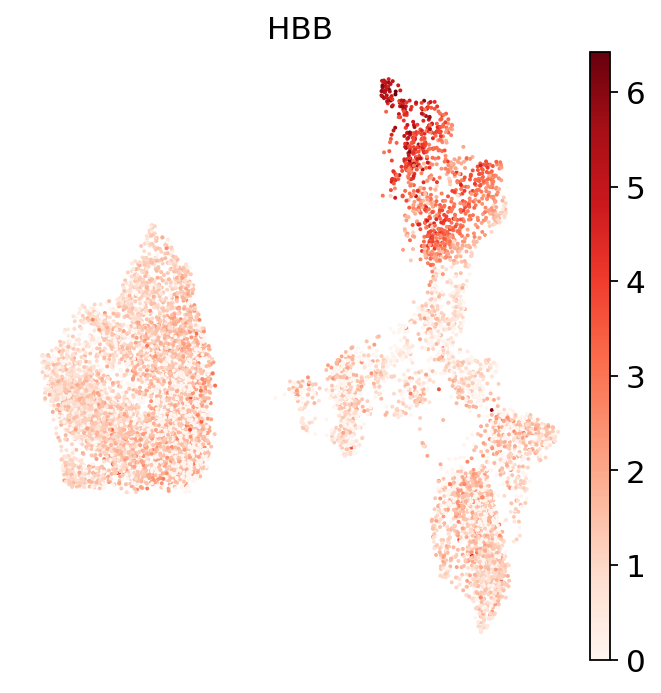

In [ ]:
sc.pl.umap(adata, color="HBB", cmap="Reds", frameon=False, sort_order=False)

In [ ]:
adata_to_map = adata.copy()
for layer in list(adata_to_map.layers.keys()):
    if layer != "counts":
        del adata_to_map.layers[layer]
adata_to_map.X = adata_to_map.layers["counts"]

In [ ]:
reference_model_features = pd.read_csv(
    "https://figshare.com/ndownloader/files/41436645", index_col=0
)

In [ ]:
adata_to_map.var["gene_names"] = adata_to_map.var.index
adata_to_map.var.set_index("gene_ids", inplace=True)

In [ ]:
reference_model_features["gene_names"] = reference_model_features.index
reference_model_features.set_index("gene_ids", inplace=True)

In [ ]:
print("Total number of genes needed for mapping:", reference_model_features.shape[0])

Total number of genes needed for mapping: 4000


In [ ]:
print(
    "Number of genes found in query dataset:",
    adata_to_map.var.index.isin(reference_model_features.index).sum(),
)

Number of genes found in query dataset: 3998


In [ ]:
missing_genes = [
    gene_id
    for gene_id in reference_model_features.index
    if gene_id not in adata_to_map.var.index
]

In [ ]:
missing_gene_adata = sc.AnnData(
    X=csr_matrix(np.zeros(shape=(adata.n_obs, len(missing_genes))), dtype="float32"),
    obs=adata.obs.iloc[:, :1],
    var=reference_model_features.loc[missing_genes, :],
)
missing_gene_adata.layers["counts"] = missing_gene_adata.X

In [ ]:
if "PCs" in adata_to_map.varm.keys():
    del adata_to_map.varm["PCs"]

In [ ]:
adata_to_map_augmented = sc.concat(
    [adata_to_map, missing_gene_adata],
    axis=1,
    join="outer",
    index_unique=None,
    merge="unique",
)

In [ ]:
adata_to_map_augmented = adata_to_map_augmented[
    :, reference_model_features.index
].copy()

In [ ]:
(adata_to_map_augmented.var.index == reference_model_features.index).all()

True

In [ ]:
adata_to_map_augmented.var["gene_ids"] = adata_to_map_augmented.var.index
adata_to_map_augmented.var.set_index("gene_names", inplace=True)

In [ ]:
adata_to_map_augmented.obs.batch.unique()

['12']
Categories (1, object): ['12']

In [ ]:
# loading model.pt from figshare
if not os.path.exists("./reference_model"):
    os.mkdir("./reference_model")
elif not os.path.exists("./reference_model/model.pt"):
    urllib.request.urlretrieve(
        "https://figshare.com/ndownloader/files/41436648",
        filename="reference_model/model.pt",
    )

In [ ]:
scarches_model = sca.models.SCVI.load_query_data(
    adata=adata_to_map_augmented,
    reference_model="./reference_model",
    freeze_dropout=True,
)

INFO     File ./reference_model/model.pt already downloaded                                                        


In [ ]:
scarches_model.train(max_epochs=500, plan_kwargs=dict(weight_decay=0.0))

INFO: GPU available: False, used: False
INFO:lightning.pytorch.utilities.rank_zero:GPU available: False, used: False
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


Epoch 500/500: 100%|██████████| 500/500 [1:00:47<00:00,  7.50s/it, v_num=1, train_loss_step=655, train_loss_epoch=654]

INFO: `Trainer.fit` stopped: `max_epochs=500` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=500` reached.


Epoch 500/500: 100%|██████████| 500/500 [1:00:47<00:00,  7.29s/it, v_num=1, train_loss_step=655, train_loss_epoch=654]


In [ ]:
adata.obsm["X_scVI"] = scarches_model.get_latent_representation()

In [ ]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata)

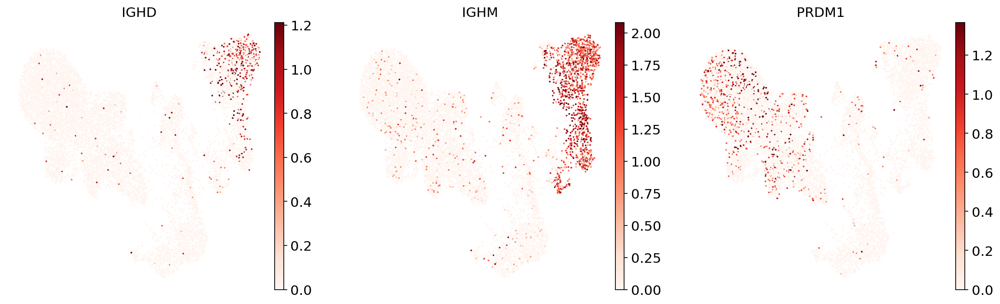

In [ ]:
sc.pl.umap(
    adata,
    color=["IGHD", "IGHM", "PRDM1"],
    vmin=0,
    vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
)

In [ ]:
ref_emb = sc.read(
    filename="reference_embedding.h5ad",
    backup_url="https://figshare.com/ndownloader/files/41376264",
)

  0%|          | 0.00/37.0M [00:00<?, ?B/s]

In [ ]:
ref_emb.obs["reference_or_query"] = "reference"

In [ ]:
ref_emb

AnnData object with n_obs × n_vars = 86332 × 10
    obs: 'donor', 'batch', 'site', 'cell_type', 'reference_or_query'
    uns: 'neighbors', 'umap'
    obsm: 'X_umap'
    obsp: 'connectivities', 'distances'

In [ ]:
adata_emb = sc.AnnData(X=adata.obsm["X_scVI"], obs=adata.obs)

In [ ]:
adata_emb.obs["reference_or_query"] = "query"

In [ ]:
emb_ref_query = sc.concat(
    [ref_emb, adata_emb],
    axis=0,
    join="outer",
    index_unique=None,
    merge="unique",
)

In [ ]:
sc.pp.neighbors(emb_ref_query)
sc.tl.umap(emb_ref_query)

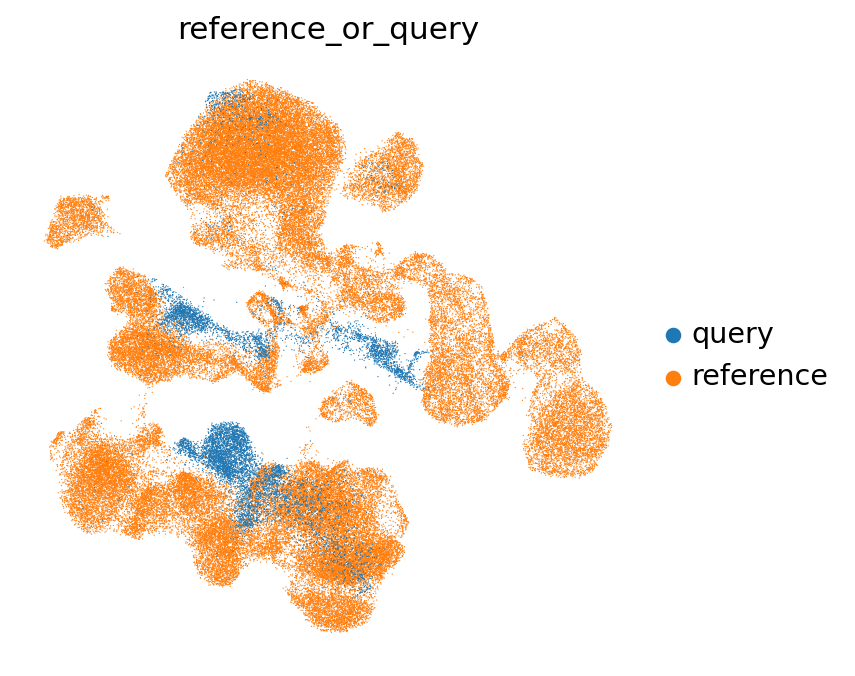

In [ ]:
sc.pl.umap(
    emb_ref_query,
    color=["reference_or_query"],
    sort_order=False,
    frameon=False,
)

In [ ]:
sc.set_figure_params(figsize=(8, 8))

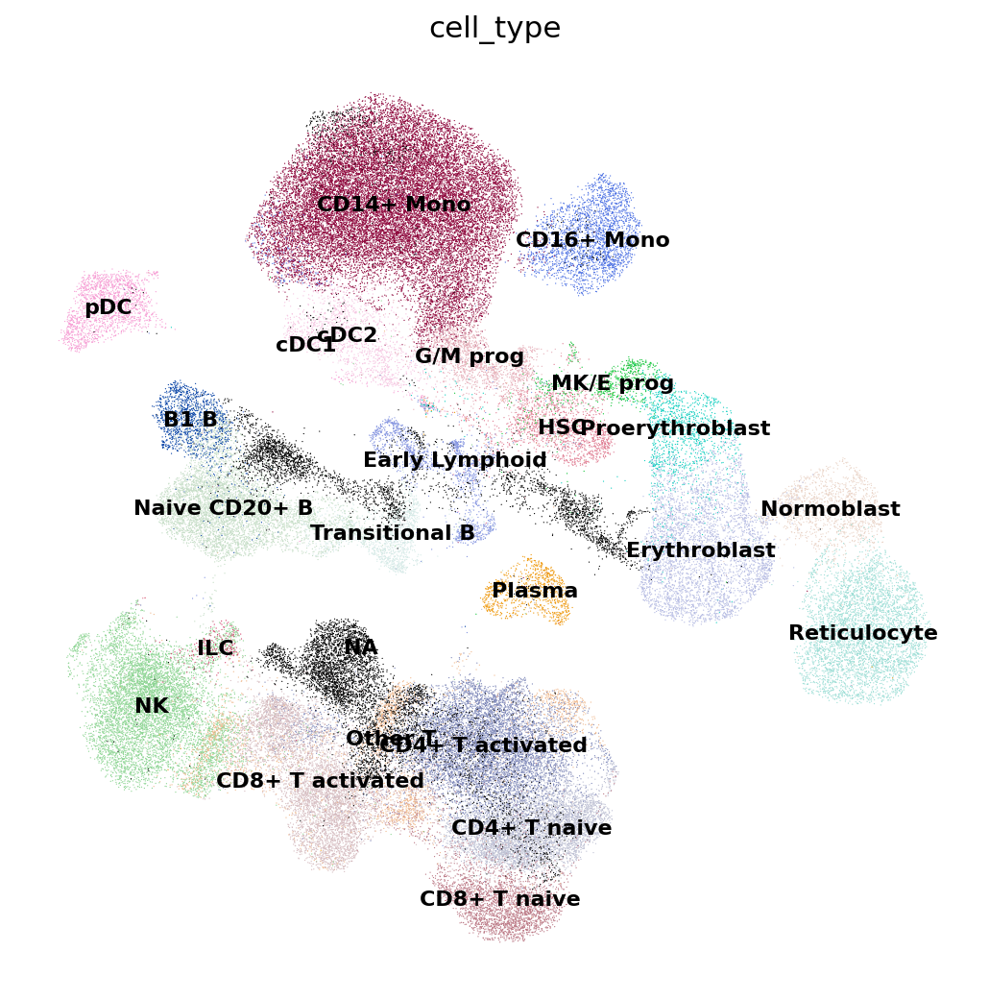

In [ ]:
sc.pl.umap(
    emb_ref_query,
    color=["cell_type"],
    sort_order=False,
    frameon=False,
    legend_loc="on data",
    legend_fontsize=10,
    na_color="black",
)

In [ ]:
knn_transformer = sca.utils.knn.weighted_knn_trainer(
    train_adata=ref_emb,
    train_adata_emb="X",  # location of our joint embedding
    n_neighbors=15,
)

Weighted KNN with n_neighbors = 15 ... 

In [ ]:
labels, uncert = sca.utils.knn.weighted_knn_transfer(
    query_adata=adata_emb,
    query_adata_emb="X",  # location of our embedding, query_adata.X in this case
    label_keys="cell_type",  # (start of) obs column name(s) for which to transfer labels
    knn_model=knn_transformer,
    ref_adata_obs=ref_emb.obs,
)

finished!


In [ ]:
adata_emb.obs["transf_cell_type"] = labels.loc[adata_emb.obs.index, "cell_type"]
adata_emb.obs["transf_cell_type_unc"] = uncert.loc[adata_emb.obs.index, "cell_type"]

In [ ]:
adata.obs.loc[adata_emb.obs.index, "transf_cell_type"] = adata_emb.obs[
    "transf_cell_type"
]
adata.obs.loc[adata_emb.obs.index, "transf_cell_type_unc"] = adata_emb.obs[
    "transf_cell_type_unc"
]

In [ ]:
sc.set_figure_params(figsize=(5, 5))

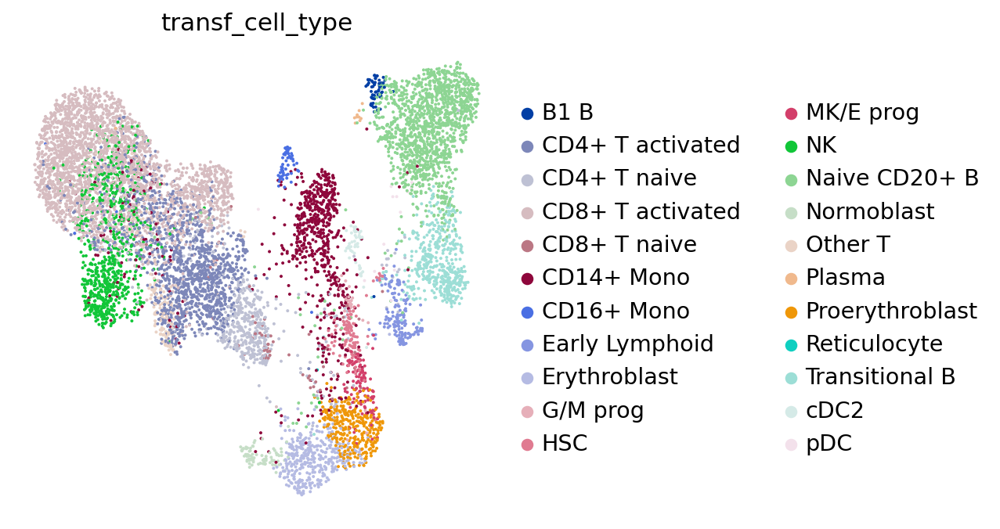

In [ ]:
sc.pl.umap(adata, color="transf_cell_type", frameon=False)

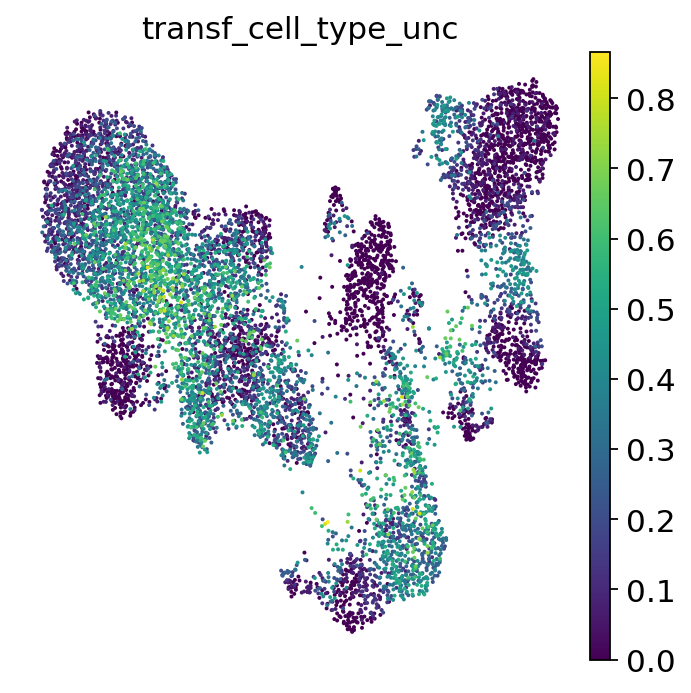

In [ ]:
sc.pl.umap(adata, color="transf_cell_type_unc", frameon=False)

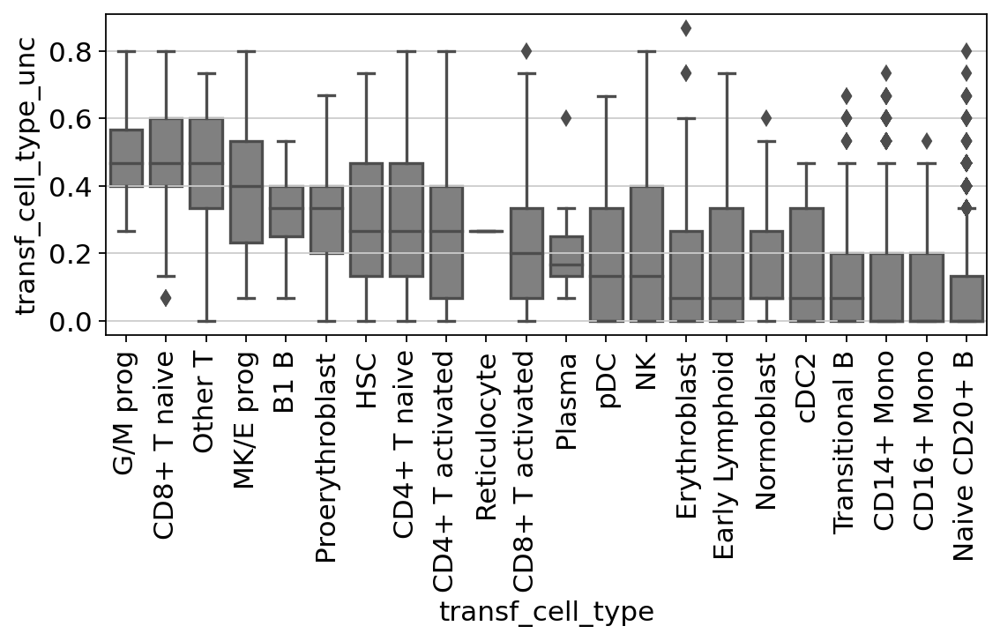

In [ ]:
fig, ax = plt.subplots(figsize=(8, 3))
ct_order = (
    adata.obs.groupby("transf_cell_type")
    .agg({"transf_cell_type_unc": "median"})
    .sort_values(by="transf_cell_type_unc", ascending=False)
)
sns.boxplot(
    adata.obs,
    x="transf_cell_type",
    y="transf_cell_type_unc",
    color="grey",
    ax=ax,
    order=ct_order.index,
)
ax.tick_params(rotation=90, axis="x")

In [ ]:
adata.obs["transf_cell_type_certain"] = adata.obs.transf_cell_type.tolist()
adata.obs.loc[
    adata.obs.transf_cell_type_unc > 0.2, "transf_cell_type_certain"
] = "Unknown"

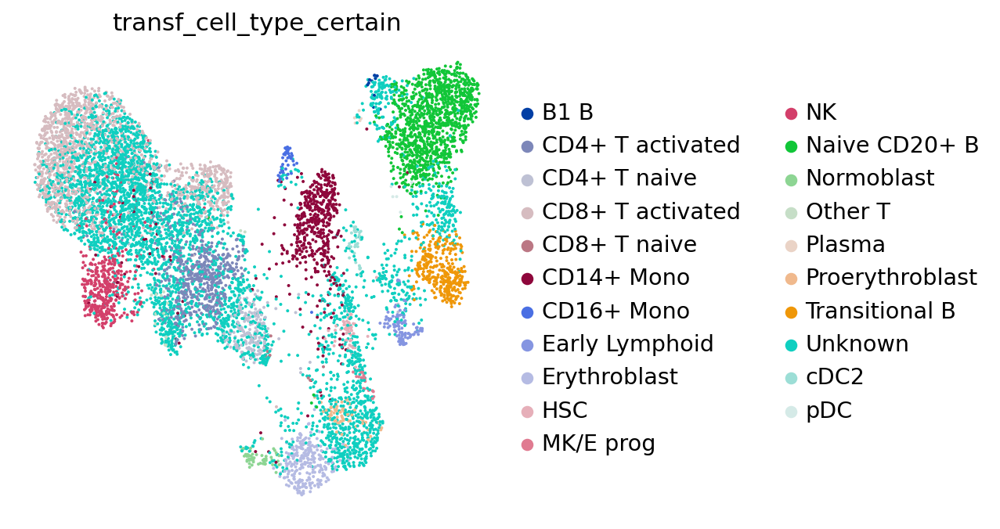

In [ ]:
sc.pl.umap(adata, color="transf_cell_type_certain", frameon=False)

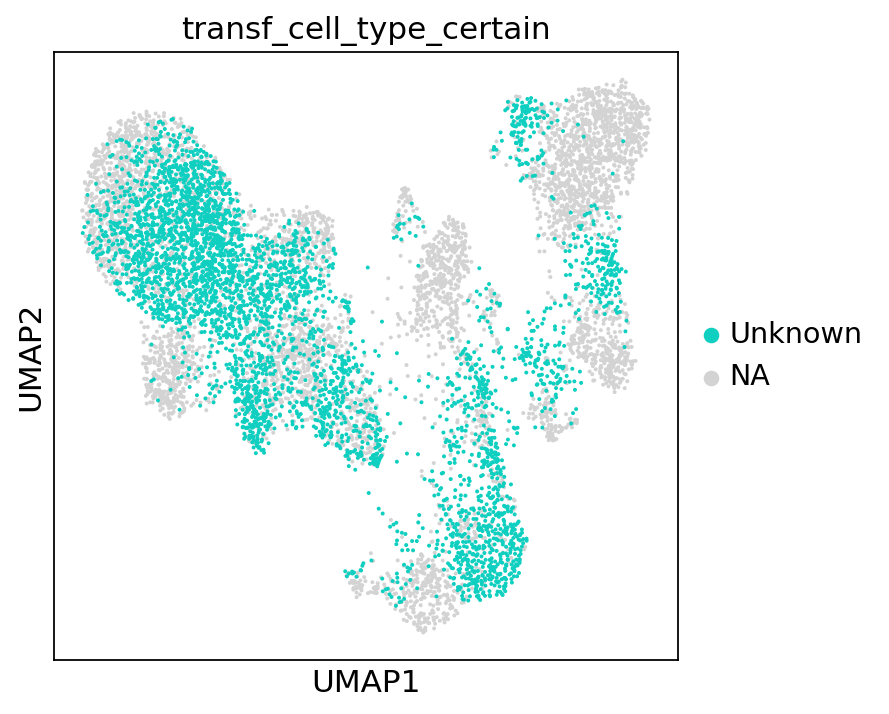

In [ ]:
sc.pl.umap(adata, color="transf_cell_type_certain", groups="Unknown")

In [ ]:
cell_types_to_check = [
    "CD14+ Mono",
    "cDC2",
    "NK",
    "B1 B",
    "CD4+ T activated",
    "T naive",
    "MK/E prog",
]

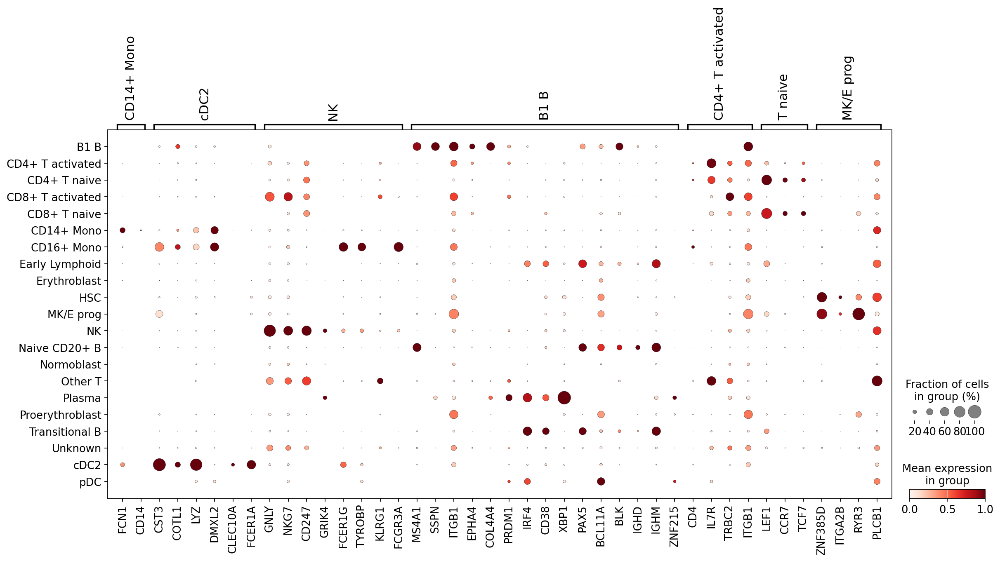

In [ ]:
sc.pl.dotplot(
    adata,
    var_names={
        ct: marker_genes_in_data[ct] for ct in cell_types_to_check
    },  # gene names grouped by cell type in a dictionary
    groupby="transf_cell_type_certain",
    standard_scale="var",  # normalize gene scores from 0 to 1
)

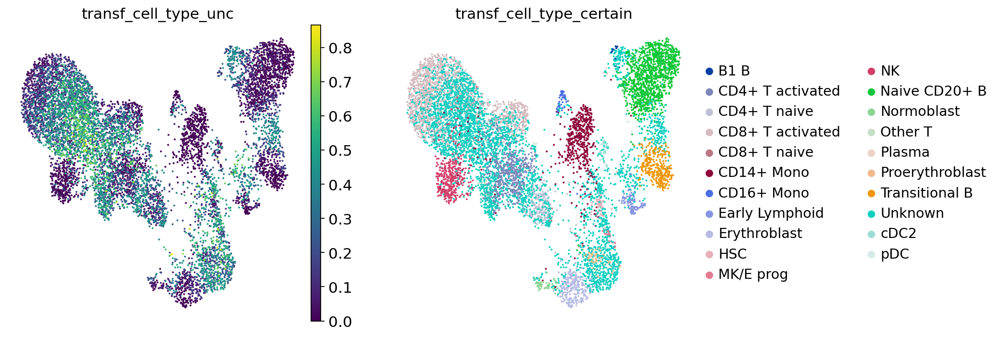

In [ ]:
sc.pl.umap(
    adata, color=["transf_cell_type_unc", "transf_cell_type_certain"], frameon=False
)


<br>
<br>
<br>

# SINGLE CELL: **Expressão diferencial - DEG**

<br>
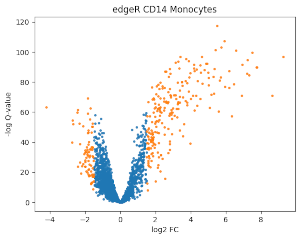

Obs: Essa analise foi realizada no python 3.9.6 AppleSilicon

**Referencia: ** https://www.sc-best-practices.org/conditions/differential_gene_expression.html

<br>
<br>
<br>
<br>

In [ ]:
pip install scanpy sc_toolbox rpy2 anndata2ri

In [ ]:
import warnings

warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import sc_toolbox

import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
from rpy2.robjects import r

sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

In [ ]:
##https://www.nature.com/articles/nbt.4042

adata = sc.read(
    filename="kang.h5ad",
    backup_url="https://figshare.com/ndownloader/files/34464122",
)
adata

AnnData object with n_obs × n_vars = 24673 × 15706
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'label', 'cluster', 'cell_type', 'replicate', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters'
    var: 'name'
    obsm: 'X_pca', 'X_umap'

In [ ]:
%%R
library(edgeR)
library(MAST)

Carregando pacotes exigidos: limma
Carregando pacotes exigidos: SingleCellExperiment
Carregando pacotes exigidos: SummarizedExperiment
Carregando pacotes exigidos: MatrixGenerics
Carregando pacotes exigidos: matrixStats

Attaching package: ‘MatrixGenerics’

The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, row

In [ ]:
adata.obs[:5]

,nCount_RNA,nFeature_RNA,tsne1,tsne2,label,cluster,cell_type,replicate,nCount_SCT,nFeature_SCT,integrated_snn_res.0.4,seurat_clusters
index,,,,,,,,,,,,
AAACATACATTTCC-1,3017.0,877,-27.640373,14.966629,ctrl,9,CD14+ Monocytes,patient_1016,1704.0,711,1,1
AAACATACCAGAAA-1,2481.0,713,-27.493646,28.924885,ctrl,9,CD14+ Monocytes,patient_1256,1614.0,662,1,1
AAACATACCATGCA-1,703.0,337,-10.468194,-5.984389,ctrl,3,CD4 T cells,patient_1488,908.0,337,6,6
AAACATACCTCGCT-1,3420.0,850,-24.367997,20.429285,ctrl,9,CD14+ Monocytes,patient_1256,1738.0,653,1,1
AAACATACCTGGTA-1,3158.0,1111,27.952170,24.159738,ctrl,4,Dendritic cells,patient_1039,1857.0,928,12,12


In [ ]:
np.max(adata.X)

3828.0

In [ ]:
adata.layers["counts"] = adata.X.copy()

In [ ]:
print(len(adata[adata.obs["label"] == "ctrl"].obs["replicate"].cat.categories))
print(len(adata[adata.obs["label"] == "stim"].obs["replicate"].cat.categories))

8
8


In [ ]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
adata

AnnData object with n_obs × n_vars = 24562 × 15701
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'label', 'cluster', 'cell_type', 'replicate', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters', 'n_genes'
    var: 'name', 'n_cells'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [ ]:
adata.obs["sample"] = [
    f"{rep}_{l}" for rep, l in zip(adata.obs["replicate"], adata.obs["label"])
]

In [ ]:
adata.obs["cell_type"] = [ct.replace(" ", "_") for ct in adata.obs["cell_type"]]
adata.obs["cell_type"] = [ct.replace("+", "") for ct in adata.obs["cell_type"]]

In [ ]:
adata.obs["replicate"] = adata.obs["replicate"].astype("category")
adata.obs["label"] = adata.obs["label"].astype("category")
adata.obs["sample"] = adata.obs["sample"].astype("category")
adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")

In [ ]:
NUM_OF_CELL_PER_DONOR = 30


def aggregate_and_filter(
    adata,
    cell_identity,
    donor_key="sample",
    condition_key="label",
    cell_identity_key="cell_type",
    obs_to_keep=[],  # which additional metadata to keep, e.g. gender, age, etc.
    replicates_per_patient=1,
):
    # subset adata to the given cell identity
    adata_cell_pop = adata[adata.obs[cell_identity_key] == cell_identity].copy()
    # check which donors to keep according to the number of cells specified with NUM_OF_CELL_PER_DONOR
    size_by_donor = adata_cell_pop.obs.groupby([donor_key]).size()
    donors_to_drop = [
        donor
        for donor in size_by_donor.index
        if size_by_donor[donor] <= NUM_OF_CELL_PER_DONOR
    ]
    if len(donors_to_drop) > 0:
        print("Dropping the following samples:")
        print(donors_to_drop)
    df = pd.DataFrame(columns=[*adata_cell_pop.var_names, *obs_to_keep])

    adata_cell_pop.obs[donor_key] = adata_cell_pop.obs[donor_key].astype("category")
    for i, donor in enumerate(donors := adata_cell_pop.obs[donor_key].cat.categories):
        print(f"\tProcessing donor {i+1} out of {len(donors)}...", end="\r")
        if donor not in donors_to_drop:
            adata_donor = adata_cell_pop[adata_cell_pop.obs[donor_key] == donor]
            # create replicates for each donor
            indices = list(adata_donor.obs_names)
            random.shuffle(indices)
            indices = np.array_split(np.array(indices), replicates_per_patient)
            for i, rep_idx in enumerate(indices):
                adata_replicate = adata_donor[rep_idx]
                # specify how to aggregate: sum gene expression for each gene for each donor and also keep the condition information
                agg_dict = {gene: "sum" for gene in adata_replicate.var_names}
                for obs in obs_to_keep:
                    agg_dict[obs] = "first"
                # create a df with all genes, donor and condition info
                df_donor = pd.DataFrame(adata_replicate.X.A)
                df_donor.index = adata_replicate.obs_names
                df_donor.columns = adata_replicate.var_names
                df_donor = df_donor.join(adata_replicate.obs[obs_to_keep])
                # aggregate
                df_donor = df_donor.groupby(donor_key).agg(agg_dict)
                df_donor[donor_key] = donor
                df.loc[f"donor_{donor}_{i}"] = df_donor.loc[donor]
    print("\n")
    # create AnnData object from the df
    adata_cell_pop = sc.AnnData(
        df[adata_cell_pop.var_names], obs=df.drop(columns=adata_cell_pop.var_names)
    )
    return adata_cell_pop

In [ ]:
%%R
fit_model <- function(adata_){
    # create an edgeR object with counts and grouping factor
    y <- DGEList(assay(adata_, "X"), group = colData(adata_)$label)
    # filter out genes with low counts
    print("Dimensions before subsetting:")
    print(dim(y))
    print("")
    keep <- filterByExpr(y)
    y <- y[keep, , keep.lib.sizes=FALSE]
    print("Dimensions after subsetting:")
    print(dim(y))
    print("")
    # normalize
    y <- calcNormFactors(y)
    # create a vector that is concatentation of condition and cell type that we will later use with contrasts
    group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    replicate <- colData(adata_)$replicate
    # create a design matrix: here we have multiple donors so also consider that in the design matrix
    design <- model.matrix(~ 0 + group + replicate)
    # estimate dispersion
    y <- estimateDisp(y, design = design)
    # fit the model
    fit <- glmQLFit(y, design)
    return(list("fit"=fit, "design"=design, "y"=y))
}

In [ ]:
obs_to_keep = ["label", "cell_type", "replicate", "sample"]

In [ ]:
adata.X = adata.layers["counts"].copy()

In [ ]:
# process first cell type separately...
cell_type = adata.obs["cell_type"].cat.categories[0]
print(
    f'Processing {cell_type} (1 out of {len(adata.obs["cell_type"].cat.categories)})...'
)
adata_pb = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)
for i, cell_type in enumerate(adata.obs["cell_type"].cat.categories[1:]):
    print(
        f'Processing {cell_type} ({i+2} out of {len(adata.obs["cell_type"].cat.categories)})...'
    )
    adata_cell_type = aggregate_and_filter(adata, cell_type, obs_to_keep=obs_to_keep)
    adata_pb = adata_pb.concatenate(adata_cell_type)


Processing B_cells (1 out of 8)...
Dropping the following samples:
['patient_1039_ctrl']
	Processing donor 16 out of 16...

Processing CD14_Monocytes (2 out of 8)...
	Processing donor 16 out of 16...

Processing CD4_T_cells (3 out of 8)...
	Processing donor 16 out of 16...

Processing CD8_T_cells (4 out of 8)...
Dropping the following samples:
['patient_101_ctrl', 'patient_1039_ctrl', 'patient_1039_stim', 'patient_107_ctrl', 'patient_107_stim', 'patient_1244_ctrl', 'patient_1244_stim']
	Processing donor 16 out of 16...

Processing Dendritic_cells (5 out of 8)...
Dropping the following samples:
['patient_1016_ctrl', 'patient_1016_stim', 'patient_101_ctrl', 'patient_1039_ctrl', 'patient_1039_stim', 'patient_107_ctrl', 'patient_107_stim']
	Processing donor 16 out of 16...

Processing FCGR3A_Monocytes (6 out of 8)...
Dropping the following samples:
['patient_1039_ctrl', 'patient_1039_stim', 'patient_107_ctrl', 'patient_107_stim', 'patient_1244_stim']
	Processing donor 16 out of 16...

Proc

In [ ]:
adata_pb.X = adata_pb.X.copy().astype(float)

In [ ]:
adata_pb.layers['counts'] = adata_pb.X.copy()

In [ ]:
sc.pp.normalize_total(adata_pb, target_sum=1e6)
sc.pp.log1p(adata_pb)
sc.pp.pca(adata_pb)

In [ ]:
adata_pb.obs["lib_size"] = np.sum(adata_pb.layers["counts"], axis=1)
adata_pb.obs["log_lib_size"] = np.log(adata_pb.obs["lib_size"].astype(float))

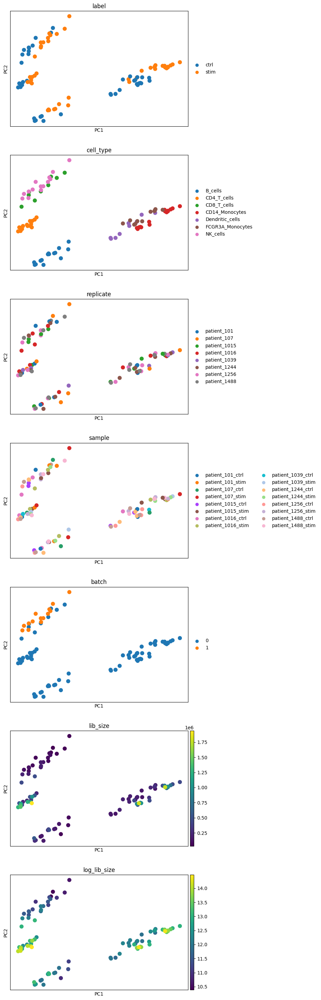

In [ ]:
sc.pl.pca(adata_pb, color=adata_pb.obs, ncols=1, size=300)

In [ ]:
adata_pb.X = adata_pb.layers['counts'].copy()

In [ ]:
adata_mono = adata_pb[adata_pb.obs["cell_type"] == "CD14_Monocytes"]
adata_mono

View of AnnData object with n_obs × n_vars = 16 × 15701
    obs: 'label', 'cell_type', 'replicate', 'sample', 'batch', 'lib_size', 'log_lib_size'
    uns: 'log1p', 'pca', 'label_colors', 'cell_type_colors', 'replicate_colors', 'sample_colors', 'batch_colors'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [ ]:
adata_mono.obs_names = [
    name.split("_")[2] + "_" + name.split("_")[3] for name in adata_mono.obs_names
]

In [ ]:
adata_mono.X = adata_mono.X.astype(float)

In [ ]:
%%time
%%R -i adata_pb -i adata_mono
outs <-fit_model(adata_mono)
print('ok')

[1] "Dimensions before subsetting:"
[1] 15701    16
[1] ""
[1] "Dimensions after subsetting:"
[1] 3709   16
[1] ""
[1] "ok"
CPU times: user 1.7 s, sys: 156 ms, total: 1.86 s
Wall time: 1.88 s


In [ ]:
%%R
fit <- outs$fit
y <- outs$y

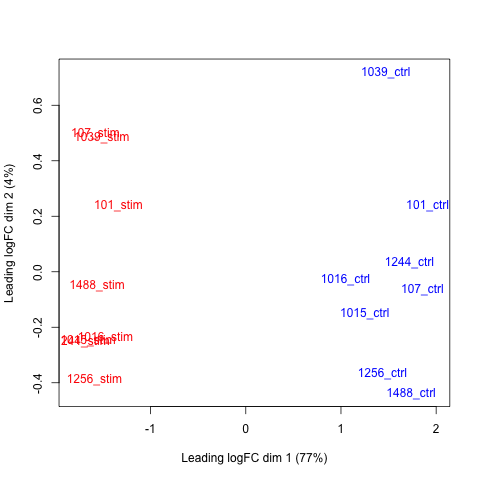

In [ ]:
%%R
plotMDS(y, col=ifelse(y$samples$group == "stim", "red", "blue"))

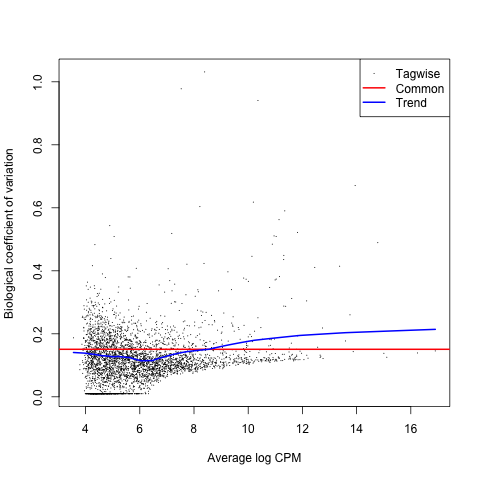

In [ ]:
%%R
plotBCV(y)

In [ ]:
%%R
colnames(y$design)

[1] "groupctrl.CD14_Monocytes" "groupstim.CD14_Monocytes"
[3] "replicatepatient_107"     "replicatepatient_1015"   
[5] "replicatepatient_1016"    "replicatepatient_1039"   
[7] "replicatepatient_1244"    "replicatepatient_1256"   
[9] "replicatepatient_1488"   


In [ ]:
%%R -o tt
myContrast <- makeContrasts('groupstim.CD14_Monocytes-groupctrl.CD14_Monocytes', levels = y$design)
qlf <- glmQLFTest(fit, contrast=myContrast)
# get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
tt <- topTags(qlf, n = Inf)
tt <- tt$table

In [ ]:
tt.shape

(3709, 5)

In [ ]:
tt[:5]

,logFC,logCPM,F,PValue,FDR
HESX1,8.345536,6.773420,1281.013295,1.837373e-15,2.766927e-12
CD38,7.126846,7.420668,1243.793133,2.266164e-15,2.766927e-12
NT5C3A,5.657050,8.327003,1218.102628,2.628780e-15,2.766927e-12
SOCS1,4.388247,6.943768,1191.289806,3.079524e-15,2.766927e-12
GMPR,6.943484,7.031832,1159.601183,3.730018e-15,2.766927e-12


In [ ]:
%%R
tr <- glmTreat(fit, contrast=myContrast, lfc=1.5)
print(head(topTags(tr)))

Coefficient:  -1*groupctrl.CD14_Monocytes 1*groupstim.CD14_Monocytes 
          logFC unshrunk.logFC    logCPM       PValue          FDR
HESX1  8.345536       8.702486  6.773420 2.108737e-14 3.535749e-11
CD38   7.126846       7.219184  7.420668 2.292459e-14 3.535749e-11
NT5C3A 5.657050       5.674640  8.327003 3.149544e-14 3.535749e-11
IL1RN  6.588583       6.596787 10.358946 4.249159e-14 3.535749e-11
GMPR   6.943484       7.047504  7.031832 4.766446e-14 3.535749e-11
DEFB1  6.654201       6.696759  8.067159 7.670147e-14 4.741429e-11


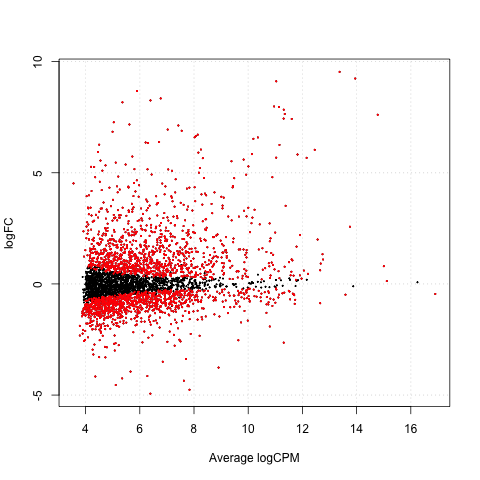

In [ ]:
%%R
plotSmear(qlf, de.tags = rownames(tt)[which(tt$FDR<0.01)])

In [ ]:
%%time
%%R -i adata_pb
outs <-fit_model(adata_pb)

[1] "Dimensions before subsetting:"
[1] 15701    90
[1] ""
[1] "Dimensions after subsetting:"
[1] 2358   90
[1] ""
CPU times: user 6.59 s, sys: 58.2 ms, total: 6.65 s
Wall time: 6.66 s


In [ ]:
%%R
fit <- outs$fit
y <- outs$y

In [ ]:
%%R -i adata_pb -o de_per_cell_type
de_per_cell_type <- list()
for (cell_type in unique(colData(adata_pb)$cell_type)) {
    print(cell_type)
    # create contrast for this cell type
    myContrast <- makeContrasts(paste0("groupstim.", cell_type, "-groupctrl.", cell_type), levels = y$design)
    # perform QLF test
    qlf <- glmQLFTest(fit, contrast=myContrast)
    # get all of the DE genes and calculate Benjamini-Hochberg adjusted FDR
    tt <- topTags(qlf, n = Inf)
    # save in the list with the results for all the cell types
    de_per_cell_type[[cell_type]] <- tt$table
}

[1] "B_cells"
[1] "CD14_Monocytes"
[1] "CD4_T_cells"
[1] "CD8_T_cells"
[1] "Dendritic_cells"
[1] "FCGR3A_Monocytes"
[1] "NK_cells"


In [ ]:
# get cell types that we ran the analysis for
cell_types = de_per_cell_type.keys()
# add the table to .uns for each cell type
for cell_type in cell_types:
    df = de_per_cell_type[cell_type]
    df["gene_symbol"] = df.index
    df["cell_type"] = cell_type
    sc_toolbox.tools.de_res_to_anndata(
        adata,
        df,
        groupby="cell_type",
        score_col="logCPM",
        pval_col="PValue",
        pval_adj_col="FDR",
        lfc_col="logFC",
        key_added="edgeR_" + cell_type,
    )
    df.to_csv(f"de_edgeR_{cell_type}.csv")

In [ ]:
sc.get.rank_genes_groups_df(adata, group="CD14_Monocytes", key="edgeR_CD14_Monocytes")[
    :5
]

,names,scores,logfoldchanges,pvals,pvals_adj
0,FTH1,16.186076,-0.57216,0.001592,0.002717
1,MALAT1,16.025682,0.010162,0.875701,0.895836
2,B2M,15.468525,0.677371,0.0,0.0
3,TMSB4X,15.054699,-0.217035,0.004681,0.007358
4,FTL,14.984911,-0.041735,0.670674,0.711253


In [ ]:
adata.X = adata.layers["counts"].copy()

In [ ]:
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)

In [ ]:
def prep_anndata(adata_):
    def fix_dtypes(adata_):
        df = pd.DataFrame(adata_.X.A, index=adata_.obs_names, columns=adata_.var_names)
        df = df.join(adata_.obs)
        return sc.AnnData(df[adata_.var_names], obs=df.drop(columns=adata_.var_names))

    adata_ = fix_dtypes(adata_)
    sc.pp.filter_genes(adata_, min_cells=3)
    return adata_

In [ ]:
adata_mono = adata[adata.obs["cell_type"] == "CD14_Monocytes"].copy()
adata_mono

AnnData object with n_obs × n_vars = 5696 × 15701
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'label', 'cluster', 'cell_type', 'replicate', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters', 'n_genes', 'sample'
    var: 'name', 'n_cells'
    uns: 'edgeR_B_cells', 'edgeR_CD14_Monocytes', 'edgeR_CD4_T_cells', 'edgeR_CD8_T_cells', 'edgeR_Dendritic_cells', 'edgeR_FCGR3A_Monocytes', 'edgeR_NK_cells', 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [ ]:
sc.pp.filter_genes(adata_mono, min_cells=3)
adata_mono

AnnData object with n_obs × n_vars = 5696 × 12268
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'label', 'cluster', 'cell_type', 'replicate', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters', 'n_genes', 'sample'
    var: 'name', 'n_cells'
    uns: 'edgeR_B_cells', 'edgeR_CD14_Monocytes', 'edgeR_CD4_T_cells', 'edgeR_CD8_T_cells', 'edgeR_Dendritic_cells', 'edgeR_FCGR3A_Monocytes', 'edgeR_NK_cells', 'log1p'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [ ]:
adata_mono = prep_anndata(adata_mono)
adata_mono

AnnData object with n_obs × n_vars = 5696 × 12268
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'label', 'cluster', 'cell_type', 'replicate', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters', 'n_genes', 'sample'
    var: 'n_cells'

In [ ]:
adata_mono.obs["cell_type"] = [
    ct.replace(" ", "_") for ct in adata_mono.obs["cell_type"]
]
adata_mono.obs["cell_type"] = [
    ct.replace("+", "") for ct in adata_mono.obs["cell_type"]
]

In [ ]:
%%R
find_de_MAST_RE <- function(adata_){
    # create a MAST object
    sca <- SceToSingleCellAssay(adata_, class = "SingleCellAssay")
    print("Dimensions before subsetting:")
    print(dim(sca))
    print("")
    # keep genes that are expressed in more than 10% of all cells
    sca <- sca[freq(sca)>0.1,]
    print("Dimensions after subsetting:")
    print(dim(sca))
    print("")
    # add a column to the data which contains scaled number of genes that are expressed in each cell
    cdr2 <- colSums(assay(sca)>0)
    colData(sca)$ngeneson <- scale(cdr2)
    # store the columns that we are interested in as factors
    label <- factor(colData(sca)$label)
    # set the reference level
    label <- relevel(label,"ctrl")
    colData(sca)$label <- label
    celltype <- factor(colData(sca)$cell_type)
    colData(sca)$celltype <- celltype
    # same for donors (which we need to model random effects)
    replicate <- factor(colData(sca)$replicate)
    colData(sca)$replicate <- replicate
    # create a group per condition-celltype combination
    colData(sca)$group <- paste0(colData(adata_)$label, ".", colData(adata_)$cell_type)
    colData(sca)$group <- factor(colData(sca)$group)
    # define and fit the model
    zlmCond <- zlm(formula = ~ngeneson + group + (1 | replicate),
                   sca=sca,
                   method='glmer',
                   ebayes=F,
                   strictConvergence=F,
                   fitArgsD=list(nAGQ = 0)) # to speed up calculations

    # perform likelihood-ratio test for the condition that we are interested in
    summaryCond <- summary(zlmCond, doLRT='groupstim.CD14_Monocytes')
    # get the table with log-fold changes and p-values
    summaryDt <- summaryCond$datatable
    result <- merge(summaryDt[contrast=='groupstim.CD14_Monocytes' & component=='H',.(primerid, `Pr(>Chisq)`)], # p-values
                     summaryDt[contrast=='groupstim.CD14_Monocytes' & component=='logFC', .(primerid, coef)],
                     by='primerid') # logFC coefficients
    # MAST uses natural logarithm so we convert the coefficients to log2 base to be comparable to edgeR
    result[,coef:=result[,coef]/log(2)]
    # do multiple testing correction
    result[,FDR:=p.adjust(`Pr(>Chisq)`, 'fdr')]
    result = result[result$FDR<0.01,, drop=F]

    result <- stats::na.omit(as.data.frame(result))
    return(result)
}

In [ ]:
%%time
%%R -i adata_mono -o res
res <-find_de_MAST_RE(adata_mono)

[1] "Dimensions before subsetting:"
[1] 12268  5696
[1] ""
[1] "Dimensions after subsetting:"
[1] 1676 5696
[1] ""


`fData` has no primerid.  I'll make something up.
`cData` has no wellKey.  I'll make something up.
Assuming data assay in position 1, with name X is log-transformed.
Loading required namespace: lme4

Done!
Combining coefficients and standard errors
Calculating log-fold changes
Calculating likelihood ratio tests
Refitting on reduced model...

Done!


CPU times: user 3min 45s, sys: 10.8 s, total: 3min 56s
Wall time: 3min 57s


In [ ]:
res[:5]

,primerid,Pr(>Chisq),coef,FDR
1,AAED1,8.410340e-19,0.709836,1.597105e-18
2,ABI1,1.401687e-05,0.312797,1.824921e-05
3,ABRACL,3.920182e-06,0.418028,5.201003e-06
4,ACADVL,2.121110e-26,-0.751305,4.656978e-26
5,ACOT9,3.424178e-151,2.921133,2.689507e-150


In [ ]:
res["gene_symbol"] = res["primerid"]
res["cell_type"] = "CD14_Monocytes"
sc_toolbox.tools.de_res_to_anndata(
    adata,
    res,
    groupby="cell_type",
    score_col="coef",
    pval_col="Pr(>Chisq)",
    pval_adj_col="FDR",
    lfc_col="coef",
    key_added="MAST_CD14_Monocytes",
)

In [ ]:
adata_copy = adata.copy()

In [ ]:
adata.X = adata.layers["counts"].copy()
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)

In [ ]:
FDR = 0.01
LOG_FOLD_CHANGE = 1.5


def plot_heatmap(adata, group_key, group_name="cell_type", groupby="label"):
    cell_type = "_".join(group_key.split("_")[1:])
    res = sc.get.rank_genes_groups_df(adata, group=cell_type, key=group_key)
    res.index = res["names"].values
    res = res[
        (res["pvals_adj"] < FDR) & (abs(res["logfoldchanges"]) > LOG_FOLD_CHANGE)
    ].sort_values(by=["logfoldchanges"])
    print(f"Plotting {len(res)} genes...")
    markers = list(res.index)
    sc.pl.heatmap(
        adata[adata.obs[group_name] == cell_type].copy(),
        markers,
        groupby=groupby,
        swap_axes=True,
    )

Plotting 303 genes...


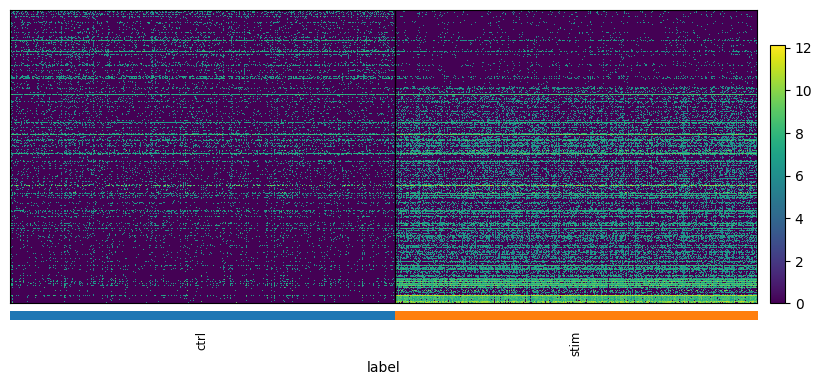

In [ ]:
plot_heatmap(adata, "edgeR_CD14_Monocytes")

Plotting 436 genes...


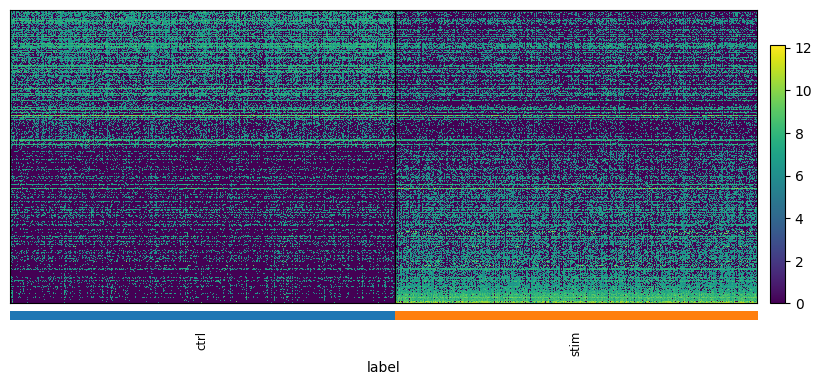

In [ ]:
plot_heatmap(adata, "MAST_CD14_Monocytes")

In [ ]:
FDR = 0.01
LOG_FOLD_CHANGE = 1.5


def volcano_plot(adata, group_key, group_name="cell_type", groupby="label", title=None):
    cell_type = "_".join(group_key.split("_")[1:])
    result = sc.get.rank_genes_groups_df(adata, group=cell_type, key=group_key).copy()
    result["-logQ"] = -np.log(result["pvals"].astype("float"))
    lowqval_de = result.loc[abs(result["logfoldchanges"]) > LOG_FOLD_CHANGE]
    other_de = result.loc[abs(result["logfoldchanges"]) <= LOG_FOLD_CHANGE]

    fig, ax = plt.subplots()
    sns.regplot(
        x=other_de["logfoldchanges"],
        y=other_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 6},
    )
    sns.regplot(
        x=lowqval_de["logfoldchanges"],
        y=lowqval_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 6},
    )
    ax.set_xlabel("log2 FC")
    ax.set_ylabel("-log Q-value")

    if title is None:
        title = group_key.replace("_", " ")
    plt.title(title)
    plt.show()

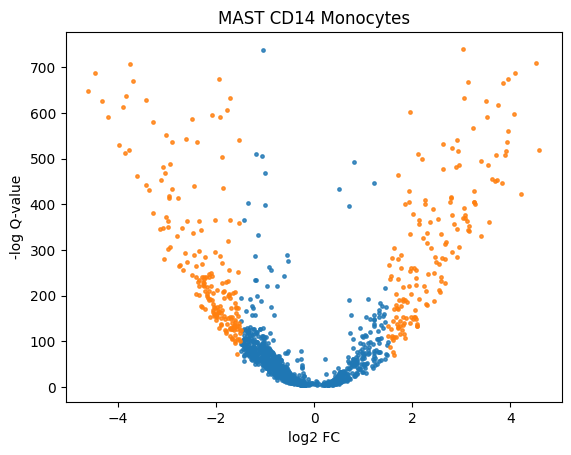

In [ ]:
volcano_plot(adata, "MAST_CD14_Monocytes")

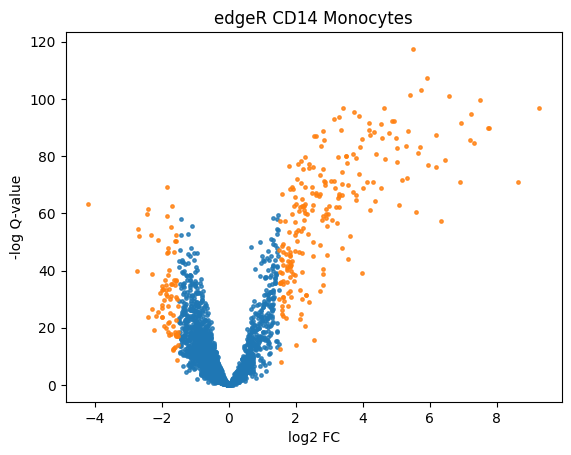

In [ ]:
volcano_plot(adata, "edgeR_CD14_Monocytes")

<br>
<br>
<br>
<br>

# SINGLE CELL: **Cell-chat**

<br>

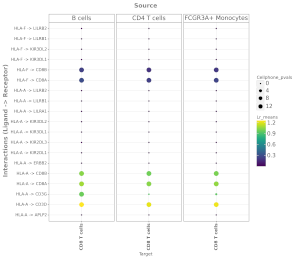

**Referencia: ** https://www.sc-best-practices.org/mechanisms/cell_cell_communication.html

<br>
<br>
<br>

In [ ]:
# python libs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import liana as li
import decoupler as dc

import session_info

In [ ]:
# Setting up R dependencies
import anndata2ri
import rpy2
from rpy2.robjects import r
import random

anndata2ri.activate()

%load_ext rpy2.ipython

In [ ]:
%%R
install.packages('reticulate')
install.packages('ggplot2')
install.packages('tidyr')
install.packages('dplyr')
install.packages('purrr')
install.packages('tibble')

In [ ]:
%%R
suppressPackageStartupMessages({
    library(reticulate)
    library(ggplot2)
    library(tidyr)
    library(dplyr)
    library(purrr)
    library(tibble)
})


    consider that it could be called from a Python process. This
    results in a quasi-obligatory segfault when rpy2 is evaluating
    R code using it. On the hand, rpy2 is accounting for the
    fact that it might already be running embedded in a Python
    process. This is why:
    - Python -> rpy2 -> R -> reticulate: crashes
    - R -> reticulate -> Python -> rpy2: works

    The issue with reticulate is tracked here:
    https://github.com/rstudio/reticulate/issues/208
    

In [ ]:
# figure settings
sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200, facecolor="white")
sc.set_figure_params(figsize=(5, 5))

In [ ]:
# Read in
adata = sc.read(
    "kang_counts_25k.h5ad", backup_url="https://figshare.com/ndownloader/files/34464122"
)
adata

# Store the counts for later use
adata.layers["counts"] = adata.X.copy()

In [ ]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

In [ ]:
# Store the counts for later use
adata.layers["counts"] = adata.X.copy()
# Rename label to condition, replicate to patient
adata.obs = adata.obs.rename({"label": "condition", "replicate": "patient"}, axis=1)
# assign sample
adata.obs["sample"] = (
    adata.obs["condition"].astype("str") + "&" + adata.obs["patient"].astype("str")
)

In [ ]:
# log1p normalize the data
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [ ]:
adata.obs["cell_type"].cat.categories

Index(['CD4 T cells', 'CD14+ Monocytes', 'B cells', 'NK cells', 'CD8 T cells',
       'FCGR3A+ Monocytes', 'Dendritic cells', 'Megakaryocytes'],
      dtype='object')

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


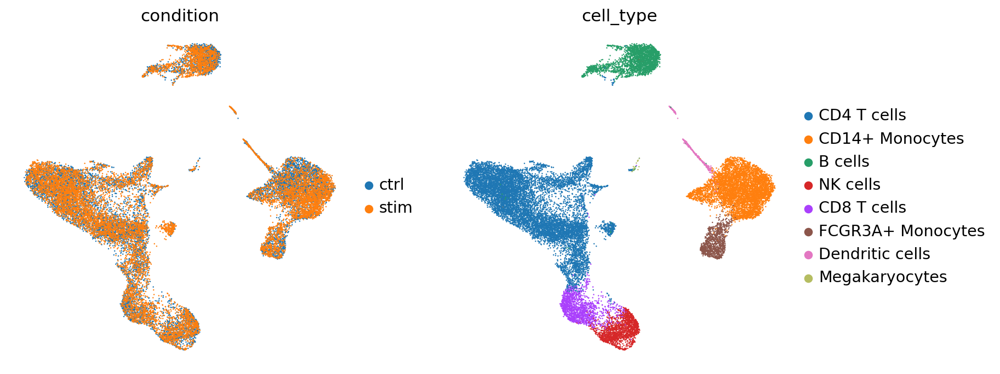

In [ ]:
sc.pl.umap(adata, color=["condition", "cell_type"], frameon=False)

In [ ]:
adata_stim = adata[adata.obs["condition"] == "stim"].copy()
adata_stim

AnnData object with n_obs × n_vars = 12301 × 15701
    obs: 'nCount_RNA', 'nFeature_RNA', 'tsne1', 'tsne2', 'condition', 'cluster', 'cell_type', 'patient', 'nCount_SCT', 'nFeature_SCT', 'integrated_snn_res.0.4', 'seurat_clusters', 'n_genes', 'sample'
    var: 'name', 'n_cells'
    uns: 'log1p', 'condition_colors', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [ ]:
# import cellphonedb method via liana
from liana.method import cellphonedb

In [ ]:
cellphonedb(
    adata_stim, groupby="cell_type", use_raw=False, return_all_lrs=True, verbose=True
)

Using `.X`!
Converting mat to CSR format
227 features of mat are empty, they will be removed.


/usr/local/lib/python3.10/dist-packages/pandas/core/indexing.py:1728: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


0.46 of entities in the resource are missing from the data.
Generating ligand-receptor stats for 12301 samples and 15474 features


100%|██████████| 1000/1000 [00:20<00:00, 49.85it/s]


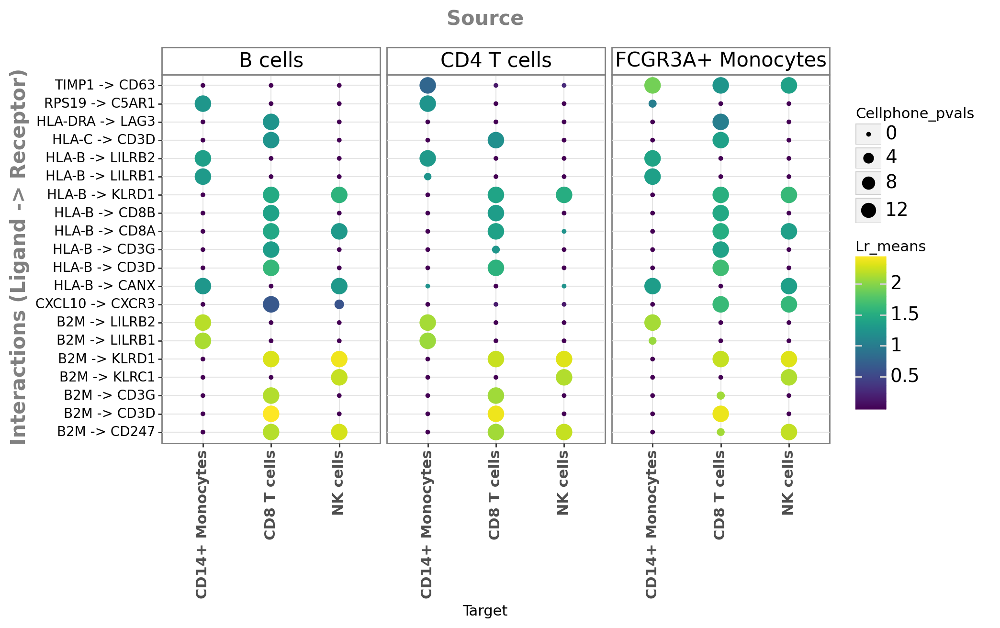

<ggplot: (8342966495097)>

In [ ]:
li.pl.dotplot(
    adata=adata_stim,
    colour="lr_means",
    size="cellphone_pvals",
    inverse_size=True,  # we inverse sign since we want small p-values to have large sizes
    # We choose only the cell types which we wish to plot
    source_labels=["CD4 T cells", "B cells", "FCGR3A+ Monocytes"],
    target_labels=["CD8 T cells", "CD14+ Monocytes", "NK cells"],
    # since cpdbv2 suggests using a filter to FPs
    # we can filter the interactions according to p-values <= 0.01
    filterby="cellphone_pvals",
    filter_lambda=lambda x: x <= 0.01,
    # as this type of methods tends to result in large numbers
    # of predictions, we can also further order according to
    # expression magnitude
    orderby="lr_means",
    orderby_ascending=False,  # we want to prioritize those with highest expression
    top_n=20,  # and we want to keep only the top 20 interactions
    figure_size=(9, 5),
    size_range=(1, 6),
)

In [ ]:
from liana.method import rank_aggregate

In [ ]:
rank_aggregate(
    adata_stim, groupby="cell_type", return_all_lrs=True, use_raw=False, verbose=True
)

Using `.X`!
Converting mat to CSR format
227 features of mat are empty, they will be removed.


/usr/local/lib/python3.10/dist-packages/pandas/core/indexing.py:1728: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


0.46 of entities in the resource are missing from the data.
Generating ligand-receptor stats for 12301 samples and 15474 features
Assuming that counts were `natural` log-normalized!
Running CellPhoneDB


100%|██████████| 1000/1000 [00:19<00:00, 52.31it/s]


Running Connectome
Running log2FC
Running NATMI
Running SingleCellSignalR
Running CellChat


100%|██████████| 1000/1000 [05:24<00:00,  3.08it/s]


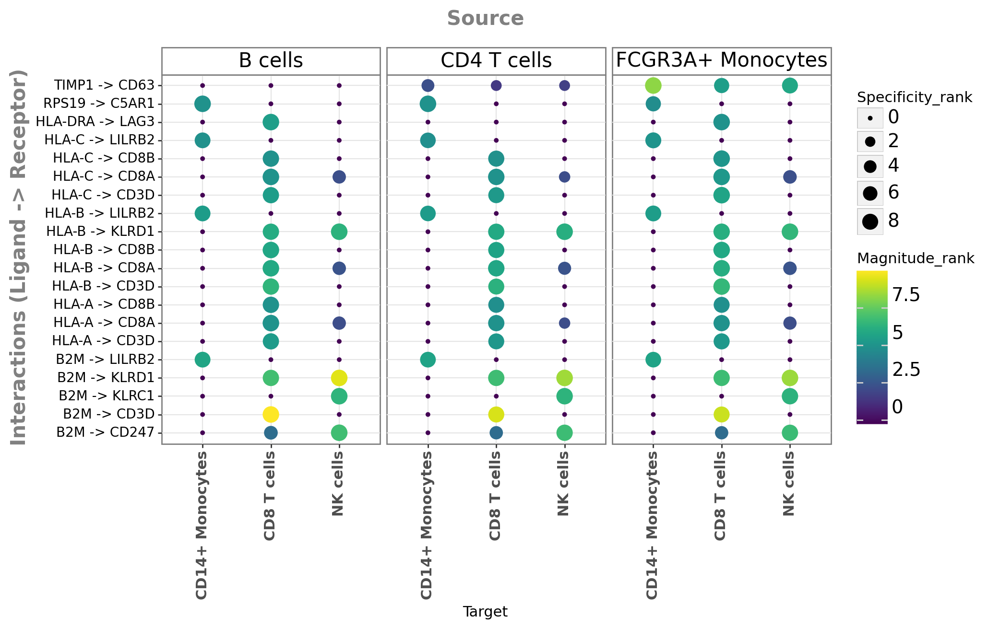

<ggplot: (8342947341349)>

In [ ]:
li.pl.dotplot(
    adata=adata_stim,
    colour="magnitude_rank",
    size="specificity_rank",
    inverse_colour=True,  # we inverse sign since we want small p-values to have large sizes
    inverse_size=True,
    # We choose only the cell types which we wish to plot
    source_labels=["CD4 T cells", "B cells", "FCGR3A+ Monocytes"],
    target_labels=["CD8 T cells", "CD14+ Monocytes", "NK cells"],
    # since the rank_aggregate can also be interpreted as a probability distribution
    # we can again filter them according to their specificity significance
    # yet here the interactions are filtered according to
    # how consistently highly-ranked is their specificity across the methods
    filterby="specificity_rank",
    filter_lambda=lambda x: x <= 0.05,
    # again, we can also further order according to magnitude
    orderby="magnitude_rank",
    orderby_ascending=True,  # prioritize those with lowest values
    top_n=20,  # and we want to keep only the top 20 interactions
    figure_size=(9, 5),
    size_range=(1, 6),
)

In [ ]:
%%R
if (!require("BiocManager", quietly = TRUE))
    install.packages("BiocManager")

BiocManager::install("limma")

In [ ]:
%%R
# load NicheNet (NicheNet is only available on GitHub)
suppressPackageStartupMessages({
    if(!require(nichenetr)) remotes::install_github("saeyslab/nichenetr", upgrade = "never")
})

library(nichenetr)

a = predict_ligand_activities

In [ ]:
!wget https://zenodo.org/record/7074291/files/ligand_target_matrix_nsga2r_final.rds

--2023-07-25 01:49:28--  https://zenodo.org/record/7074291/files/ligand_target_matrix_nsga2r_final.rds
Resolving zenodo.org (zenodo.org)... 188.185.124.72
Connecting to zenodo.org (zenodo.org)|188.185.124.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 262116605 (250M) [application/octet-stream]
Saving to: ‘ligand_target_matrix_nsga2r_final.rds’

ligand_target_matri 100%[===================>] 249.97M   724KB/s    in 6m 33s  

2023-07-25 01:56:03 (651 KB/s) - ‘ligand_target_matrix_nsga2r_final.rds’ saved [262116605/262116605]



In [ ]:
%%R
# Increase timeout threshold
options(timeout=600)

# Load PK
ligand_target_matrix <- readRDS("ligand_target_matrix_nsga2r_final.rds")
lr_network <- readRDS(url("https://zenodo.org/record/7074291/files/lr_network_human_21122021.rds"))

In [ ]:
sender_celltypes = ["CD4 T cells", "B cells", "FCGR3A+ Monocytes"]
receiver_celltypes = ["CD8 T cells"]

In [ ]:
# Helper function to obtain sufficiently expressed genes
from functools import reduce


def get_expressed_genes(adata, cell_type, expr_prop):
    # calculate proportions
    temp = adata[adata.obs["cell_type"] == cell_type, :]
    a = temp.X.getnnz(axis=0) / temp.X.shape[0]
    stats = (
        pd.DataFrame({"genes": temp.var_names, "props": a})
        .assign(cell_type=cell_type)
        .sort_values("genes")
    )

    # obtain expressed genes
    stats = stats[stats["props"] >= expr_prop]
    expressed_genes = stats["genes"].values

    return expressed_genes

In [ ]:
sender_expressed = reduce(
    np.union1d,
    [
        get_expressed_genes(adata, cell_type=cell_type, expr_prop=0.1)
        for cell_type in sender_celltypes
    ],
)
receiver_expressed = reduce(
    np.union1d,
    [
        get_expressed_genes(adata, cell_type=cell_type, expr_prop=0.1)
        for cell_type in receiver_celltypes
    ],
)

In [ ]:
%%R -i sender_expressed -i receiver_expressed
# get ligands and receptors in the resource
ligands <- lr_network %>% pull(from) %>% unique()
receptors <- lr_network %>% pull(to) %>% unique()

# only keep the intersect between the resource and the data
expressed_ligands <- intersect(ligands, sender_expressed)
expressed_receptors <- intersect(receptors, receiver_expressed)

# filter the network to only include ligands for which both the ligand and receptor are expressed
potential_ligands <- lr_network %>%
  filter(from %in% expressed_ligands & to %in% expressed_receptors) %>%
  pull(from) %>% unique()

In [ ]:
# Get pseudo-bulk profile
pdata = dc.get_pseudobulk(
    adata,
    sample_col="sample",
    groups_col="cell_type",
    min_prop=0.1,
    min_smpls=3,
    layer="counts",
)

In [ ]:
# Storing the raw counts
pdata.layers["counts"] = pdata.X.copy()

# Does PC1 captures a meaningful biological or technical fact?
pdata.obs["lib_size"] = pdata.X.sum(1)

# Normalize
sc.pp.normalize_total(pdata, target_sum=1e4)
sc.pp.log1p(pdata)
# check how this looks like
pdata

AnnData object with n_obs × n_vars = 110 × 15701
    obs: 'condition', 'cell_type', 'patient', 'sample', 'psbulk_n_cells', 'psbulk_counts', 'lib_size'
    var: 'name', 'n_cells'
    uns: 'log1p'
    layers: 'psbulk_props', 'counts'

In [ ]:
logFCs, pvals = dc.get_contrast(
    pdata,
    group_col="cell_type",
    condition_col="condition",
    condition="stim",
    reference="ctrl",
    method="t-test",
)

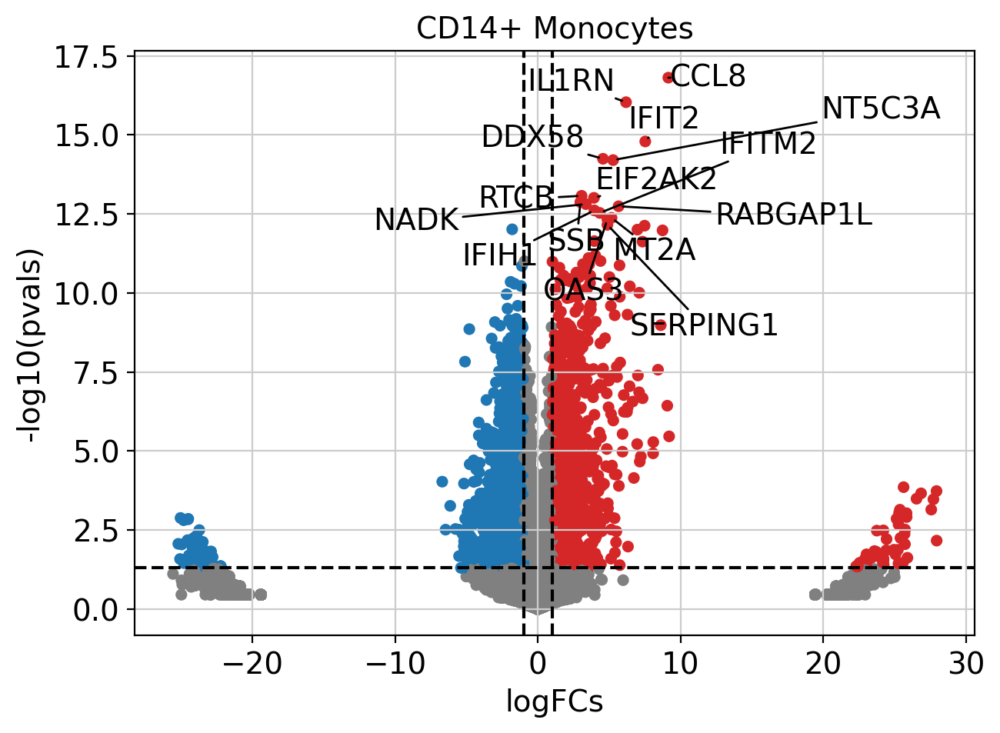

In [ ]:
# Visualize those for e.g. CD14+ Monocytes
dc.plot_volcano(logFCs, pvals, "CD14+ Monocytes", top=15, sign_thr=0.05, lFCs_thr=1)

In [ ]:
# format results
deg = dc.format_contrast_results(logFCs, pvals)
# only keep the receiver cell type(s)
deg = deg[np.isin(deg["contrast"], receiver_celltypes)]
deg.head()

,contrast,name,logFCs,pvals,adj_pvals
47103,CD8 T cells,IFIT3,6.394436,2.549010e-11,0.0
47104,CD8 T cells,SAMD9L,3.586875,5.000206e-11,0.0
47105,CD8 T cells,IFIT1,6.539666,7.268960e-11,0.0
47106,CD8 T cells,IFI6,5.609078,5.827544e-10,0.000002
47107,CD8 T cells,OAS1,5.570021,1.092566e-09,0.000003


In [ ]:
# define background of sufficiently expressed genes
background_genes = deg["name"].values

# only keep significant and positive DE genes
deg = deg[(deg["pvals"] <= 0.05) & (deg["logFCs"] > 1)]
# get geneset of interest
geneset_oi = deg["name"].values

In [ ]:
%%R -i geneset_oi -i background_genes -o ligand_activities

ligand_activities <- predict_ligand_activities(geneset = geneset_oi,
                                               background_expressed_genes = background_genes,
                                               ligand_target_matrix = ligand_target_matrix,
                                               potential_ligands = potential_ligands)

ligand_activities <- ligand_activities %>%
  arrange(-aupr) %>%
  mutate(rank = rank(desc(aupr)))

# show top10 ligand activities
head(ligand_activities, n=10)

# A tibble: 10 × 6
   test_ligand auroc   aupr aupr_corrected pearson  rank
   <chr>       <dbl>  <dbl>          <dbl>   <dbl> <dbl>
 1 PTPRC       0.791 0.0798         0.0650  0.148      1
 2 HLA-F       0.771 0.0674         0.0525  0.142      2
 3 HLA-A       0.767 0.0599         0.0450  0.136      3
 4 HLA-E       0.763 0.0546         0.0397  0.109      4
 5 HLA-B       0.759 0.0536         0.0387  0.125      5
 6 CD48        0.761 0.0503         0.0354  0.0958     6
 7 CCL5        0.758 0.0487         0.0338  0.0733     7
 8 ITGB2       0.731 0.0469         0.0320  0.116      8
 9 B2M         0.749 0.0450         0.0301  0.0927     9
10 HLA-DRA     0.749 0.0434         0.0286  0.0988    10


In [ ]:
%%R -o vis_ligand_target
top_ligands <- ligand_activities %>%
  top_n(15, aupr) %>%
  arrange(-aupr) %>%
  pull(test_ligand) %>%
  unique()

# get regulatory potentials
ligand_target_potential <- map(top_ligands,
                               ~get_weighted_ligand_target_links(.x,
                                                                 geneset = geneset_oi,
                                                                 ligand_target_matrix = ligand_target_matrix,
                                                                 n = 500)
                              ) %>%
    bind_rows() %>%
    drop_na()

# prep for visualization
active_ligand_target_links <-
  prepare_ligand_target_visualization(ligand_target_df = ligand_target_potential,
                                      ligand_target_matrix = ligand_target_matrix)

# order ligands & targets
order_ligands <- intersect(top_ligands,
                           colnames(active_ligand_target_links)) %>% rev() %>% make.names()
order_targets <- ligand_target_potential$target %>%
  unique() %>%
  intersect(rownames(active_ligand_target_links)) %>%
  make.names()
rownames(active_ligand_target_links) <- rownames(active_ligand_target_links) %>%
  make.names() # make.names() for heatmap visualization of genes like H2-T23
colnames(active_ligand_target_links) <- colnames(active_ligand_target_links) %>%
  make.names() # make.names() for heatmap visualization of genes like H2-T23

vis_ligand_target <- active_ligand_target_links[order_targets, order_ligands] %>%
  t()

# convert to dataframe, and then it's returned to py
vis_ligand_target <- vis_ligand_target %>%
    as.data.frame() %>%
    rownames_to_column("ligand") %>%
    as_tibble()

In [ ]:
# convert dot to underscore and set ligand as index
vis_ligand_target["ligand"] = vis_ligand_target["ligand"].replace("\.", "_", regex=True)
vis_ligand_target.set_index("ligand", inplace=True)
# keep only columns where at least one gene has a regulatory potential >= 0.05
vis_ligand_target = vis_ligand_target.loc[
    :, vis_ligand_target[vis_ligand_target >= 0.05].any()
]
vis_ligand_target.head()

,AIM2,CCL2,CCL3,CD69,CXCL10,GBP1,GBP4,IFIH1,IFIT2,IFITM1,...,OAS3,CD38,GBP2,EHD4,HAVCR2,IL18RAP,PARP8,PIM2,SPCS3,ZBP1
ligand,,,,,,,,,,,,,,,,,,,,,
HLA_DQB1,0.000000,0.009779,0.000000,0.007720,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
IL15,0.149317,0.133514,0.191512,0.202307,0.085065,0.206406,0.061923,0.010933,0.078044,0.088810,...,0.073824,0.120233,0.060531,0.074099,0.07433,0.099282,0.085015,0.133337,0.079955,0.075642
CXCL11,0.000000,0.009682,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
ICAM1,0.008415,0.019244,0.070233,0.011545,0.013325,0.006771,0.007813,0.008649,0.010065,0.007597,...,0.006798,0.008493,0.008395,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
CXCL10,0.000000,0.014246,0.000000,0.008737,0.010101,0.000000,0.000000,0.000000,0.006990,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000


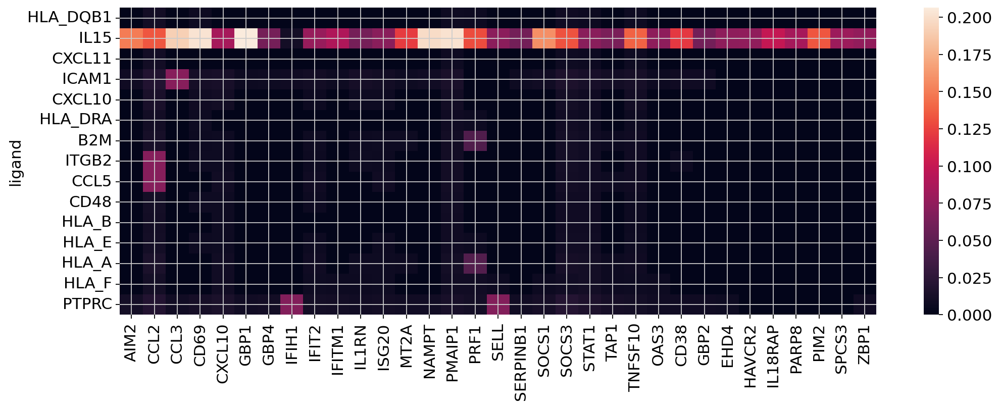

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
sns.heatmap(vis_ligand_target, xticklabels=True, ax=ax)
plt.show()

In [ ]:
ligand_oi = ligand_activities.head(3)["test_ligand"].values

In [ ]:
ligand_oi

array(['PTPRC', 'HLA-F', 'HLA-A'], dtype=object)

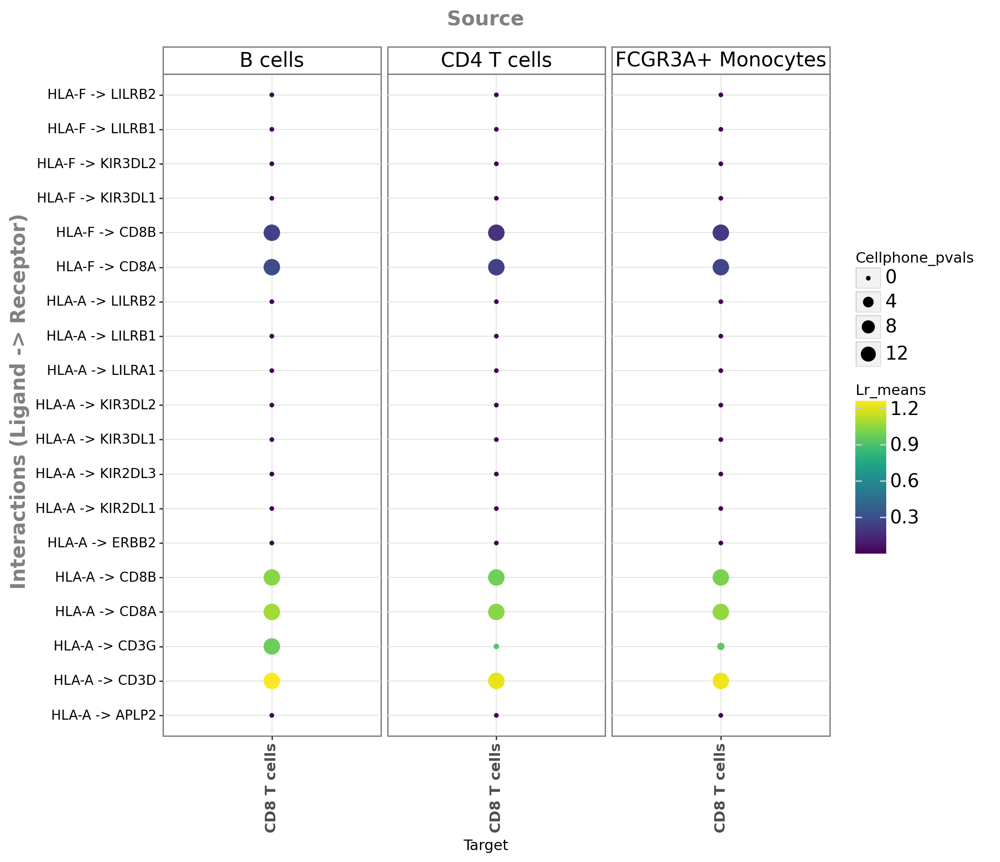

<ggplot: (8342940768869)>

In [ ]:
li.pl.dotplot(
    adata=adata_stim,
    colour="lr_means",
    size="cellphone_pvals",
    inverse_size=True,  # we inverse sign since we want small p-values to have large sizes
    # We choose only the cell types which we wish to plot
    source_labels=sender_celltypes,
    target_labels=receiver_celltypes,
    # keep only those ligands
    filterby="ligand_complex",
    filter_lambda=lambda x: np.isin(x, ligand_oi),
    # as this type of methods tends to result in large numbers
    # of predictions, we can also further order according to
    # expression magnitude
    orderby="magnitude_rank",
    orderby_ascending=False,  # we want to prioritize those with highest expression
    top_n=25,  # and we want to keep only the top 25 interactions
    figure_size=(9, 9),
    size_range=(1, 6),
)

<br>
<br>
<br>
<br>

# SINGLE CELL: **Trajetória**

<br>
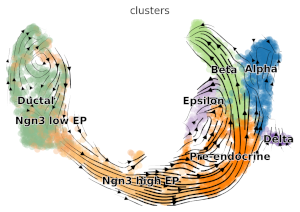

**Referencia: ** https://www.sc-best-practices.org/trajectories/pseudotemporal.html

<br>
<br>
<br>

In [ ]:
from pathlib import Path

import scanpy as sc

In [ ]:
DATA_DIR = Path("./datadir/")
DATA_DIR.mkdir(parents=True, exist_ok=True)

FILE_NAME = DATA_DIR / "bone_marrow.h5ad"


In [ ]:
adata = sc.read(
    filename=FILE_NAME,
    backup_url="https://figshare.com/ndownloader/files/35826944",
)
adata

  0%|          | 0.00/370M [00:00<?, ?B/s]

AnnData object with n_obs × n_vars = 5780 × 27876
    obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential'
    var: 'palantir'
    uns: 'clusters_colors', 'palantir_branch_probs_cell_types'
    obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs'
    layers: 'spliced', 'unspliced'

In [ ]:
sc.pp.filter_genes(adata, min_counts=20)
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata)

sc.tl.pca(adata)
sc.pp.neighbors(adata, n_pcs=10)

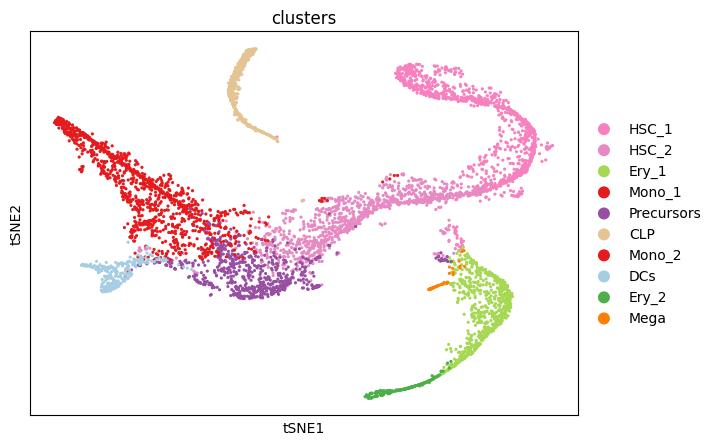

In [ ]:
sc.pl.scatter(adata, basis="tsne", color="clusters")

In [ ]:
sc.tl.diffmap(adata)

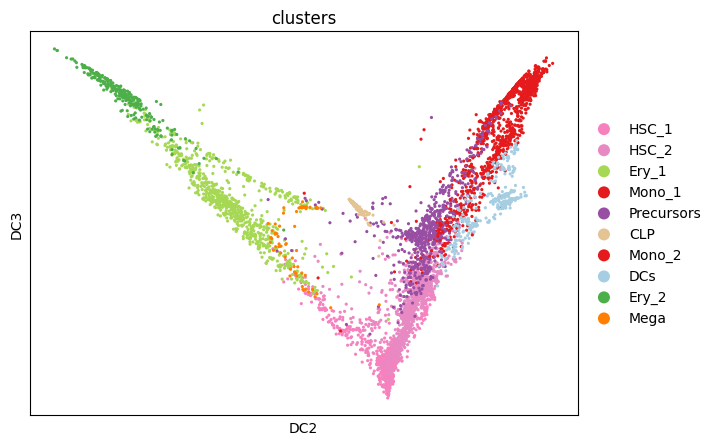

In [ ]:
# Setting root cell as described above
root_ixs = adata.obsm["X_diffmap"][:, 3].argmin()
sc.pl.scatter(
    adata,
    basis="diffmap",
    color=["clusters"],
    components=[2, 3],
)

adata.uns["iroot"] = root_ixs

In [ ]:
sc.tl.dpt(adata)

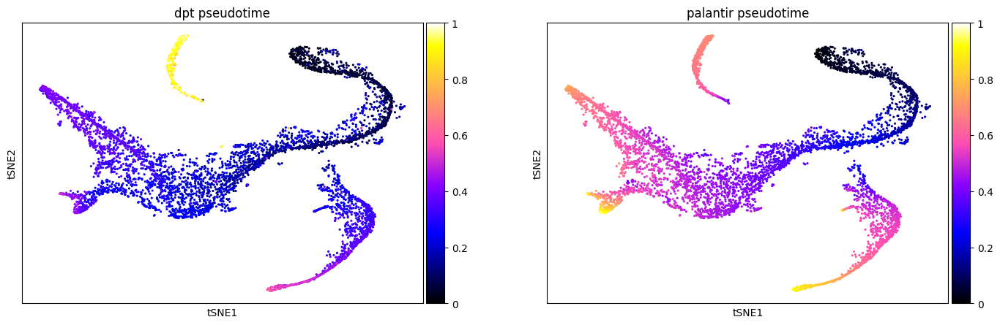

In [ ]:
sc.pl.scatter(
    adata,
    basis="tsne",
    color=["dpt_pseudotime", "palantir_pseudotime"],
    color_map="gnuplot2",
)

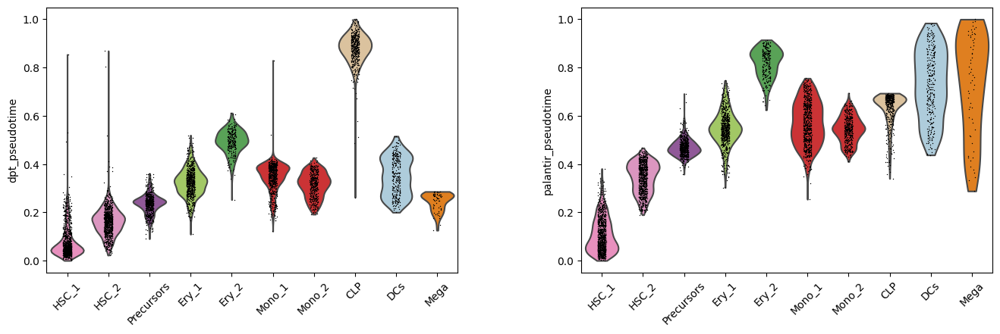

In [ ]:
sc.pl.violin(
    adata,
    keys=["dpt_pseudotime", "palantir_pseudotime"],
    groupby="clusters",
    rotation=45,
    order=[
        "HSC_1",
        "HSC_2",
        "Precursors",
        "Ery_1",
        "Ery_2",
        "Mono_1",
        "Mono_2",
        "CLP",
        "DCs",
        "Mega",
    ],
)

In [ ]:
import scvelo as scv

In [ ]:
scv.settings.set_figure_params("scvelo")

In [ ]:

FILE_PATH = DATA_DIR / "pancreas.h5ad"

In [ ]:
adata = scv.datasets.pancreas(file_path=FILE_PATH)
adata

  0%|          | 0.00/50.0M [00:00<?, ?B/s]

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score'
    var: 'highly_variable_genes'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'distances', 'connectivities'

In [ ]:
scv.pp.filter_and_normalize(adata, min_shared_counts=20, n_top_genes=2000)

Filtered out 20801 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.


In [ ]:
sc.tl.pca(adata)
sc.pp.neighbors(adata)
scv.pp.moments(adata, n_pcs=None, n_neighbors=None)

computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


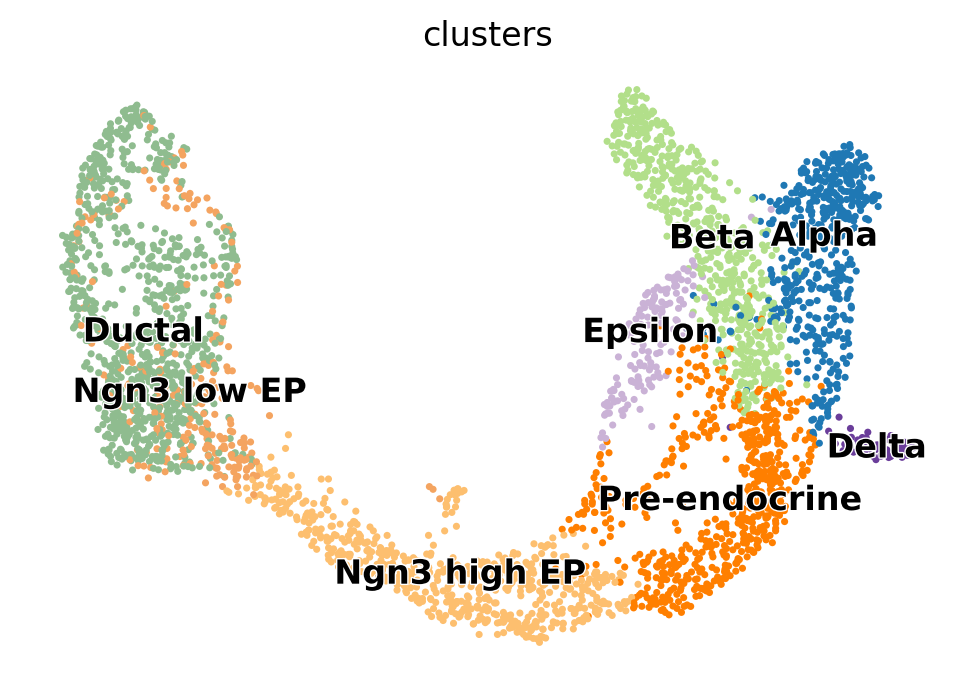

In [ ]:
scv.pl.scatter(adata, basis="umap", color="clusters")

In [ ]:
scv.tl.velocity(adata, mode="deterministic")

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


computing velocity graph (using 2/2 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:30) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


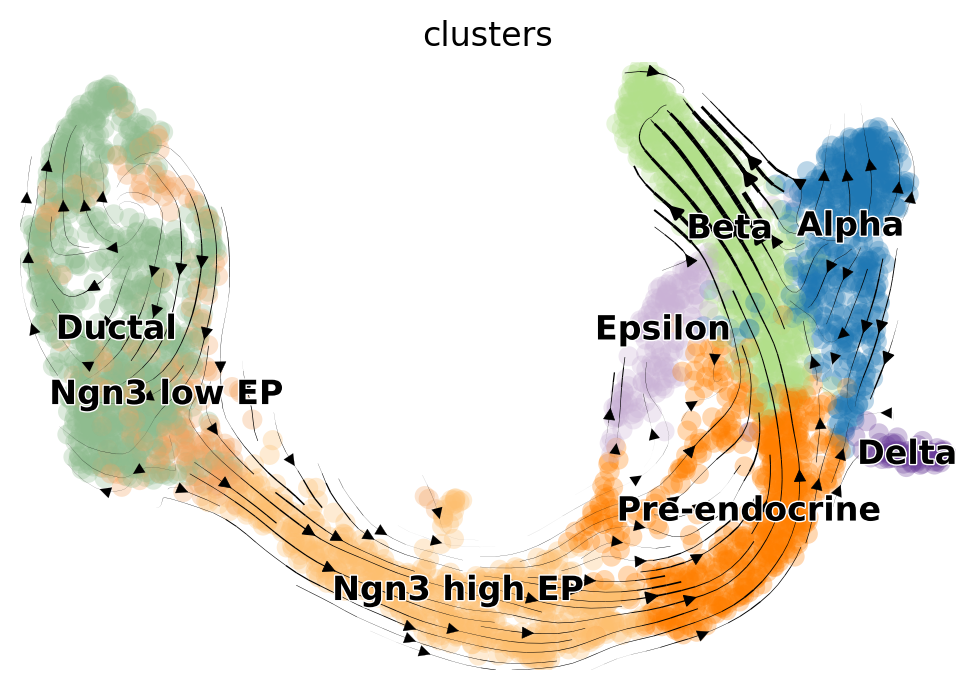

In [ ]:
scv.tl.velocity_graph(adata, n_jobs=8)
scv.pl.velocity_embedding_stream(adata, basis="umap", color="clusters")

In [ ]:
scv.tl.recover_dynamics(adata, n_jobs=8)

recovering dynamics (using 2/2 cores)


  0%|          | 0/835 [00:00<?, ?gene/s]

    finished (0:06:59) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


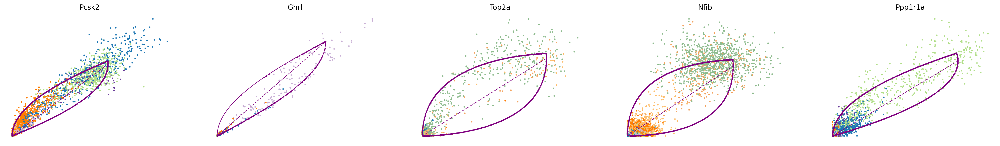

In [ ]:
top_genes = adata.var["fit_likelihood"].sort_values(ascending=False).index
scv.pl.scatter(adata, basis=top_genes[:5], color="clusters", frameon=False)

computing velocities
    finished (0:00:06) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 2/2 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


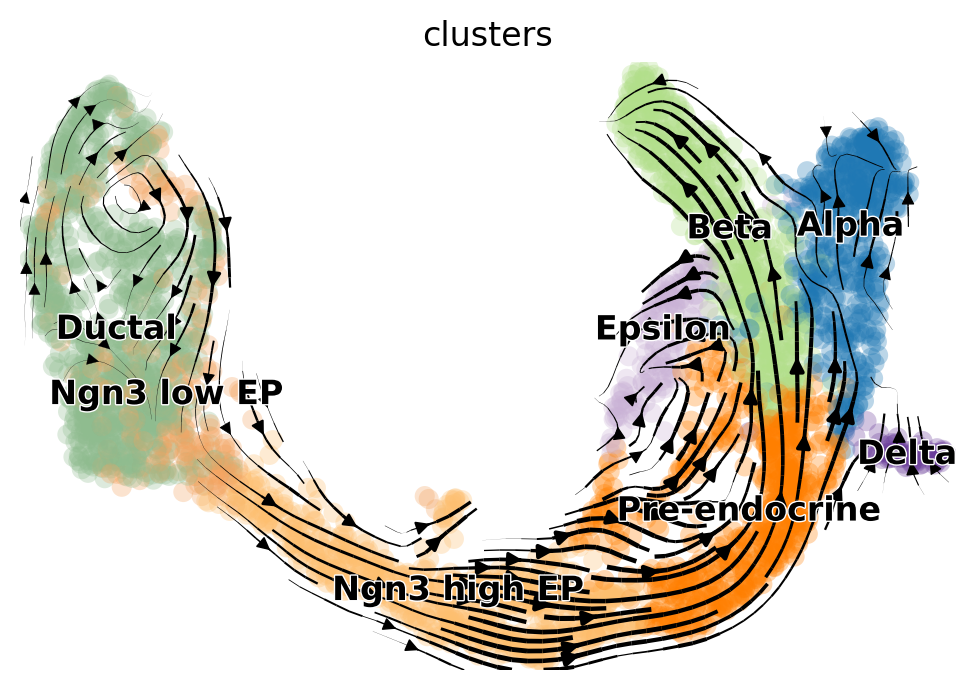

In [ ]:
scv.tl.velocity(adata, mode="dynamical")
scv.tl.velocity_graph(adata, n_jobs=8)
scv.pl.velocity_embedding_stream(adata, basis="umap")

In [ ]:
!wget -qO data.tar.gz "https://zenodo.org/record/5847462/files/KPTracer-Data.tar.gz?download=1"

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
!tar -xvzf data.tar.gz

In [ ]:
!git clone https://github.com/YosefLab/Cassiopeia.git

Cloning into 'Cassiopeia'...
remote: Enumerating objects: 12510, done.
remote: Counting objects: 100% (811/811), done.
remote: Compressing objects: 100% (281/281), done.
remote: Total 12510 (delta 549), reused 751 (delta 526), pack-reused 11699
Receiving objects: 100% (12510/12510), 45.50 MiB | 6.87 MiB/s, done.
Resolving deltas: 100% (8925/8925), done.


In [ ]:
import sys
sys.path.append('/content/Cassiopeia/cassiopeia/')

In [ ]:
!cd Cassiopeia && make install

In [ ]:
import cassiopeia as cas
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc



In [ ]:
from cassiopeia.preprocess import lineage_utils

In [ ]:
allele_table = pd.read_csv(
    "KPTracer-Data/KPTracer.alleleTable.FINAL.txt", sep="\t", index_col=0
)

allele_table.head(5)

<ipython-input-10-93f653358b92>:1: DtypeWarning: Columns (12) have mixed types. Specify dtype option on import or set low_memory=False.
  allele_table = pd.read_csv(


,cellBC,intBC,r1,r2,r3,allele,sampleID,UMI,readCount,Tumor,MetFamily,ES_clone
0,L9.TTTGTCATCTGTCAAG-1,TTCCCTATTTGCTA,CGCCG[111:2D]AAATG,GATAT[None]CTCTG,AATTC[220:1I]GGCGGA,CGCCG[111:2D]AAATGGATAT[None]CTCTGAATTC[220:1I...,L9,54,796,3724_NT_T1,3724_NT_T1,2E1
1,L9.TTTGTCATCTGTCAAG-1,TGTTTTTGTCTGCA,CGCCG[111:1I]AAAAAA,CATGT[151:19D]TGGTT,TTAAT[218:2D]GCGGA,CGCCG[111:1I]AAAAAACATGT[151:19D]TGGTTTTAAT[21...,L9,13,209,3724_NT_T1,3724_NT_T1,2E1
2,L9.TTTGTCATCTGTCAAG-1,TGTGAAGGTCAATA,CCGAA[113:49D]GATAT,CCGAA[113:49D]GATAT,AATTC[220:5D]GGACA,CCGAA[113:49D]GATATCCGAA[113:49D]GATATAATTC[22...,L9,68,1193,3724_NT_T1,3724_NT_T1,2E1
3,L9.TTTGTCATCTGTCAAG-1,TCAGGCGATGCGAA,CGCCG[111:1I]AAAAAA,CGATA[166:1I]TTCTCT,TAATT[219:2D]CGGAG,CGCCG[111:1I]AAAAAACGATA[166:1I]TTCTCTTAATT[21...,L9,43,745,3724_NT_T1,3724_NT_T1,2E1
4,L9.TTTGTCATCTGTCAAG-1,TATGATTAGTCGCG,CGCCG[111:1D]AAAAT,GATAT[167:54D]CGGAG,GATAT[167:54D]CGGAG,CGCCG[111:1D]AAAATGATAT[167:54D]CGGAGGATAT[167...,L9,27,530,3724_NT_T1,3724_NT_T1,2E1


In [ ]:
all_tumors = allele_table["Tumor"].unique()
primary_nt_tumors = [
    tumor
    for tumor in all_tumors
    if "NT" in tumor and tumor.split("_")[2].startswith("T")
]

primary_nt_allele_table = allele_table[allele_table["Tumor"].isin(primary_nt_tumors)]

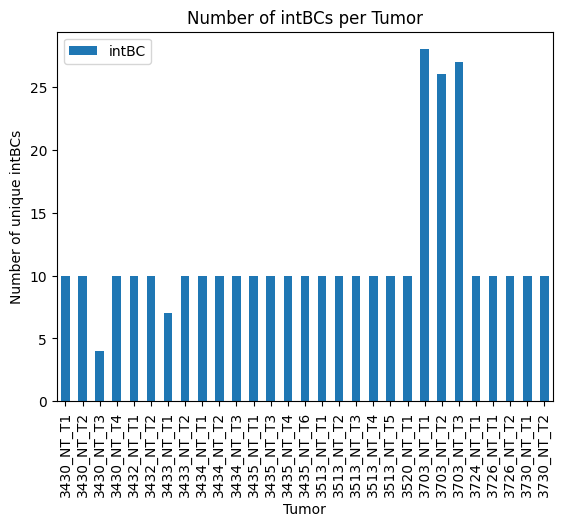

In [ ]:
primary_nt_allele_table.groupby(["Tumor"]).agg({"intBC": "nunique"}).plot(kind="bar")
plt.ylabel("Number of unique intBCs")
plt.title("Number of intBCs per Tumor")
plt.show()

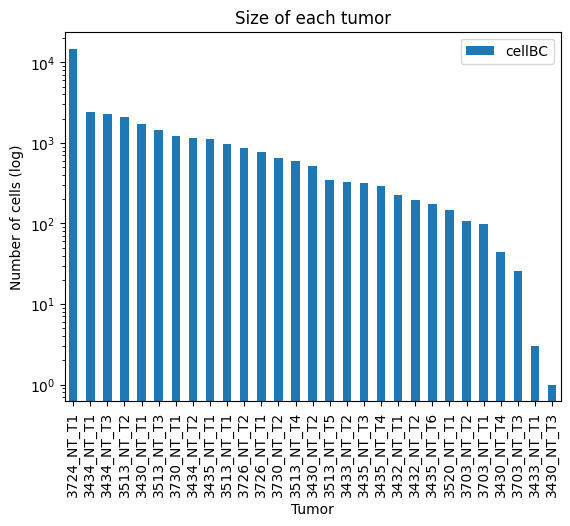

In [ ]:
primary_nt_allele_table.groupby(["Tumor"]).agg({"cellBC": "nunique"}).sort_values(
    by="cellBC", ascending=False
).plot(kind="bar")
plt.yscale("log")
plt.ylabel("Number of cells (log)")
plt.title("Size of each tumor")
plt.show()

In [ ]:
indel_priors = cas.pp.compute_empirical_indel_priors(
    allele_table, grouping_variables=["intBC", "MetFamily"]
)

indel_priors.sort_values(by="count", ascending=False).head()

,count,freq
indel,,
TAATT[219:2D]CGGAG,664.0,0.764977
CGCCG[111:1I]AAAAAA,584.0,0.672811
CGCCG[111:1D]AAAAT,504.0,0.580645
CGCCG[111:2D]AAATG,401.0,0.461982
AATTC[220:3D]GAGGA,395.0,0.455069


In [ ]:
indel_priors.sort_values(by="count").head(5)

,count,freq
indel,,
ATATC[168:49I]GTTGTGGCCCAACATGGCAGCGTGCCGTAGCTTAGTTGTCAGGCCATTTGCTGG,1.0,0.001152
ACGCC[110:2D]AGAAT,1.0,0.001152
CATCT[101:15D]TGGCC,1.0,0.001152
CCCGG[111:3D]ATTGG,1.0,0.001152
CCGAA[113:1I]GGAATG,1.0,0.001152


In [ ]:
# utility functions for computing summary statistics


def compute_percent_indels(character_matrix):
    """Computes the percentage of sites carrying indels in a character matrix.

    Args:
        character_matrix: A pandas Dataframe summarizing the mutation status of each cell.

    Returns:
        A percentage of sites in cells that contain an edit.
    """
    all_vals = character_matrix.values.ravel()
    num_not_missing = len([n for n in all_vals if n != -1])
    num_uncut = len([n for n in all_vals if n == 0])

    return 1.0 - (num_uncut / num_not_missing)


def compute_percent_uncut(cell):
    """Computes the percentage of sites uncut in a cell.

    Args:
        A vector containing the edited sites for a particular cell.

    Returns:
        The number of sites uncut in a cell.
    """
    uncut = 0
    for i in cell:
        if i == 0:
            uncut += 1
    return uncut / max(1, len([i for i in cell if i != -1]))


def summarize_tumor_quality(
    allele_table,
    minimum_intbc_thresh=0.2,
    minimum_number_of_cells=2,
    maximum_percent_uncut_in_cell=0.8,
    allele_rep_thresh=0.98,
):
    """Compute QC statistics for each tumor.

    Computes statistics for each clone that will be used for filtering tumors for downstream lineage reconstruction.

    Args:
        allele_table: A Cassipoeia allele table summarizing the indels on each molecule in each cell.
        min_intbc_thresh: The minimum proportion of cells that an intBC must appear in to be considered
            for downstream reconstruction.
        minimum_number_of_cells: Minimum number of cells in a tumor to be processed in this QC pipeline.
        maximum_percent_uncut_in_cell: The maximum percentage of sites allowed to be uncut in a cell. If
            a cell exceeds this threshold, it is filtered out.
        allele_rep_thresh: Maximum allele representation in a single cut site allowed. If a character has
            less diversity than allowed, it is filtered out.

    Returns:
        A pandas Dataframe summarizing the quality-control information for each tumor.
    """

    tumor_statistics = {}
    NUMBER_OF_SITES_PER_INTBC = 3

    # iterate through Tumors and compute summary statistics
    for tumor_name, tumor_allele_table in allele_table.groupby("Tumor"):

        if tumor_allele_table["cellBC"].nunique() < minimum_number_of_cells:
            continue

        tumor_allele_table = allele_table[allele_table["Tumor"] == tumor_name].copy()
        tumor_allele_table["lineageGrp"] = tumor_allele_table["Tumor"].copy()
        lineage_group = lineage_utils.filter_intbcs_final_lineages(
            tumor_allele_table, min_intbc_thresh=minimum_intbc_thresh
        )[0]

        number_of_cutsites = (
            len(lineage_group["intBC"].unique()) * NUMBER_OF_SITES_PER_INTBC
        )

        character_matrix, _, _ = cas.pp.convert_alleletable_to_character_matrix(
            lineage_group, allele_rep_thresh=allele_rep_thresh
        )

        # We'll hit this if we filter out all characters with the specified allele_rep_thresh
        if character_matrix.shape[1] == 0:
            character_matrix, _, _ = cas.pp.convert_alleletable_to_character_matrix(
                lineage_group, allele_rep_thresh=1.0
            )

        number_dropped_intbcs = number_of_cutsites - character_matrix.shape[1]
        percent_uncut = character_matrix.apply(
            lambda x: compute_percent_uncut(x.values), axis=1
        )

        # drop normal cells from lineage (cells without editing)
        character_matrix_filtered = character_matrix[
            percent_uncut < maximum_percent_uncut_in_cell
        ]

        percent_unique = (
            character_matrix_filtered.drop_duplicates().shape[0]
            / character_matrix_filtered.shape[0]
        )
        tumor_statistics[tumor_name] = (
            percent_unique,
            compute_percent_indels(character_matrix_filtered),
            number_dropped_intbcs,
            1.0 - (number_dropped_intbcs / number_of_cutsites),
            character_matrix_filtered.shape[0],
        )

    tumor_clone_statistics = pd.DataFrame.from_dict(
        tumor_statistics,
        orient="index",
        columns=[
            "PercentUnique",
            "CutRate",
            "NumSaturatedTargets",
            "PercentUnsaturatedTargets",
            "NumCells",
        ],
    )

    return tumor_clone_statistics

In [ ]:
tumor_clone_statistics = summarize_tumor_quality(primary_nt_allele_table)

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TTTTGTGTTTCATCr2', 'TTTTGTGTTTCATCr3', 'TTACATGCTACCCCr1', 'TTACATGCTACCCCr2', 'TTACATGCTACCCCr3', 'ACGTGCAAGGACGCr1', 'ACGTGCAAGGACGCr2', 'ACGTGCAAGGACGCr3', 'ACATTATTAGATACr1', 'ACATTATTAGATACr2', 'ACATTATTAGATACr3']


Processing characters:   0%|          | 0/4 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['CTCTTTTCAGTTCAr1', 'CTCTTTTCAGTTCAr2', 'ACATCTGCGAGATTr1', 'ACATCTGCGAGATTr2', 'ACATTATTAGATACr1', 'ACATTATTAGATACr2', 'ACATTATTAGATACr3', 'ACGTGCAAGGACGCr2', 'ACGTGCAAGGACGCr3', 'GATAGCACAAAACGr3', 'TCTATACTGACGGAr1', 'TCTATACTGACGGAr2', 'TTACATGCTACCCCr1', 'TTACATGCTACCCCr2', 'TTTTGTGTTTCATCr2']


Processing characters:   0%|          | 0/9 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACGTGCAAGGACGCr3']


Processing characters:   0%|          | 0/26 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['CTCTTTTCAGTTCAr1', 'GATAGCACAAAACGr3', 'TTTTGTGTTTCATCr1']


Processing characters:   0%|          | 0/27 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACGTGCAAGGACGCr1', 'CTCTTTTCAGTTCAr1', 'CTCTTTTCAGTTCAr2', 'TTTTGTGTTTCATCr1']


Processing characters:   0%|          | 0/23 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TATGCCGCCAGTTTr1', 'TATGCCGCCAGTTTr2', 'TTTTGTGTTTCATCr1', 'TTTTGTGTTTCATCr2', 'TTTTGTGTTTCATCr3', 'TCTATACTGACGGAr1', 'TCTATACTGACGGAr2', 'TCTATACTGACGGAr3']


Processing characters:   0%|          | 0/13 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TATGCCGCCAGTTTr1', 'TATGCCGCCAGTTTr2', 'TTACATGCTACCCCr2', 'TTTTGTGTTTCATCr1', 'TTTTGTGTTTCATCr2', 'ACATCTGCGAGATTr1', 'ACATCTGCGAGATTr2', 'TCTATACTGACGGAr2']


Processing characters:   0%|          | 0/13 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACATTATTAGATACr1', 'ACATTATTAGATACr2', 'CTCTTTTCAGTTCAr1', 'CTCTTTTCAGTTCAr2', 'CTCTTTTCAGTTCAr3', 'ACATCTGCGAGATTr1', 'ACATCTGCGAGATTr2', 'ACATCTGCGAGATTr3', 'ACGTGCAAGGACGCr1', 'ACGTGCAAGGACGCr2', 'ACGTGCAAGGACGCr3', 'GTGCAAGCCTTATCr1', 'GTGCAAGCCTTATCr2', 'GATAGCACAAAACGr2', 'TATGCCGCCAGTTTr1', 'TATGCCGCCAGTTTr2', 'TATGCCGCCAGTTTr3', 'TTACATGCTACCCCr1', 'TTACATGCTACCCCr2', 'TTACATGCTACCCCr3']


Processing characters:   0%|          | 0/4 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACGTGCAAGGACGCr1', 'ACGTGCAAGGACGCr2', 'CTCTTTTCAGTTCAr1', 'CTCTTTTCAGTTCAr2', 'CTCTTTTCAGTTCAr3', 'ACATTATTAGATACr1', 'ACATTATTAGATACr2', 'TCTATACTGACGGAr1', 'TTTTGTGTTTCATCr2']


Processing characters:   0%|          | 0/9 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TATGCCGCCAGTTTr1']


Processing characters:   0%|          | 0/29 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACGTGCAAGGACGCr1', 'ACGTGCAAGGACGCr2', 'CTCTTTTCAGTTCAr1', 'CTCTTTTCAGTTCAr2', 'GTGCAAGCCTTATCr3', 'TTACATGCTACCCCr1', 'TTACATGCTACCCCr2', 'TTTTGTGTTTCATCr1']


Processing characters:   0%|          | 0/22 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TATGATTAGTCGCGr1', 'TATGATTAGTCGCGr3', 'GTTTATTTCCGTATr1', 'GTTTATTTCCGTATr2', 'GTTTATTTCCGTATr3', 'GCCTACTTAAGTCCr1', 'GCCTACTTAAGTCCr2', 'GCCTACTTAAGTCCr3', 'TGTGAAGGTCAATAr1', 'TGTGAAGGTCAATAr2', 'TTCCCTATTTGCTAr1', 'TTCCCTATTTGCTAr2']


Processing characters:   0%|          | 0/3 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TTCCCTATTTGCTAr2', 'TGATATAAATCTTTr2', 'TCAGGCGATGCGAAr2', 'TATGATTAGTCGCGr2']


Processing characters:   0%|          | 0/26 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TTCCCTATTTGCTAr2', 'GTTTATTTCCGTATr2', 'GTTTATTTCCGTATr3']


Processing characters:   0%|          | 0/27 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TTCCCTATTTGCTAr2', 'TGTTTTTGTCTGCAr2']


Processing characters:   0%|          | 0/28 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TGATATAAATCTTTr1', 'TGATATAAATCTTTr2', 'TGATATAAATCTTTr3']


Processing characters:   0%|          | 0/27 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['CGCCTCACCAAGCCr1', 'CGGCTGATTATATTr3', 'TTAATTGGTTCACTr3']


Processing characters:   0%|          | 0/66 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['CTCTTTGGTTCCTCr1', 'CTCTTTGGTTCCTCr2', 'CTGGACCGACAAAGr1', 'CTGGACCGACAAAGr2', 'CTGGACCGACAAAGr3', 'AAGTTTTATGTTGCr2', 'ACTTCGAACAACCCr1', 'ACTTCGAACAACCCr2', 'ACTTCGAACAACCCr3', 'AGTGTATTATAGCTr3', 'CCGAGATATAGGCTr2', 'CCGAGATATAGGCTr3', 'CGCAGATTATCAATr1', 'CGCAGATTATCAATr2', 'CGCAGATTATCAATr3', 'CGCCTCACCAAGCCr1', 'CGCCTCACCAAGCCr2', 'CGGACCTACTCTGCr1', 'CGGACCTACTCTGCr2', 'CGGACCTACTCTGCr3', 'CGTGCCATATTTAGr1', 'CGTGCCATATTTAGr2', 'CGTGCCATATTTAGr3', 'CTCCCGACTCATACr1', 'CTCCCGACTCATACr3', 'CTGGTCCAGTTTTCr1', 'CTGGTCCAGTTTTCr2', 'CTGGTCCAGTTTTCr3', 'GCCACCGATTTCTAr1', 'GCCACCGATTTCTAr2', 'GCCACCGATTTCTAr3', 'TAAATACTTACCTCr1', 'TAAATACTTACCTCr2', 'TAAATACTTACCTCr3', 'TCGGGGCACTGCTCr1', 'TCGGGGCACTGCTCr2', 'TCGGGGCACTGCTCr3', 'TGCGTATCCTTGGGr2', 'TGCGTATCCTTGGGr3', 'TTAATTGGTTCACTr2', 'TTCCCGCAAGACAAr1', 'TTCCCGCAAGACAAr2', 'AGACAAGTGTGTTGr1', 'AGACAAGTGTGTTGr3', 'CATCTGTTCCCGGGr1', 'CATCTGTTCCCGGGr2']


Processing characters:   0%|          | 0/26 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['CTCCCGACTCATACr3', 'CTGGACCGACAAAGr1', 'CTCTTTGGTTCCTCr2', 'TAAATACTTACCTCr2', 'CGCCTCACCAAGCCr1', 'CGCCTCACCAAGCCr2', 'CTGGTCCAGTTTTCr2', 'TTCCCGCAAGACAAr2']


Processing characters:   0%|          | 0/67 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['TTCCCTATTTGCTAr2', 'TGTTTTTGTCTGCAr1', 'TGTGAAGGTCAATAr1', 'TGTGAAGGTCAATAr2', 'TGTGAAGGTCAATAr3', 'TCAGGCGATGCGAAr1', 'TCAGGCGATGCGAAr2', 'TCAGGCGATGCGAAr3', 'TATGATTAGTCGCGr1', 'TATGATTAGTCGCGr2', 'TATGATTAGTCGCGr3', 'GTTTATTTCCGTATr2', 'GTTTATTTCCGTATr3', 'GCCTACTTAAGTCCr1', 'GCCTACTTAAGTCCr2', 'ACTCTGCTCCAGATr1', 'ACTCTGCTCCAGATr2', 'ACTCTGCTCCAGATr3', 'ACAGGTGCTCAAATr2', 'TGATATAAATCTTTr1', 'TGATATAAATCTTTr2', 'TGATATAAATCTTTr3']


Processing characters:   0%|          | 0/8 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: ['ACTCTGCTCCAGATr2', 'ACTCTGCTCCAGATr3', 'TGATATAAATCTTTr2', 'TTCCCTATTTGCTAr2']


Processing characters:   0%|          | 0/23 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

Dropping the following intBCs due to lack of diversity with threshold 0.98: []


Processing characters:   0%|          | 0/30 [00:00<?, ?it/s]

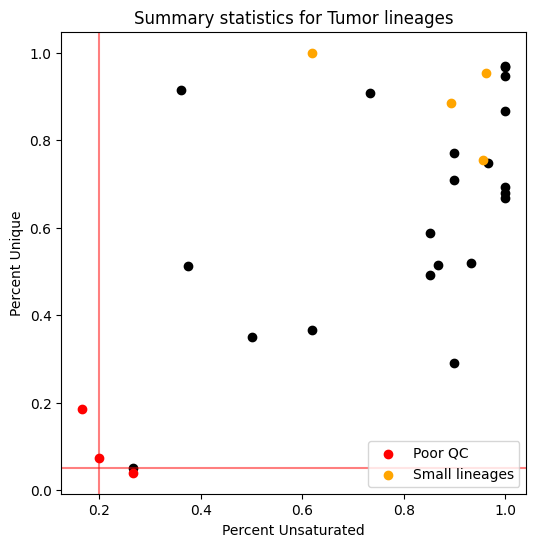

In [ ]:
NUM_CELLS_THRESH = 100
PERCENT_UNIQUE_THRESH = 0.05
PERCENT_UNSATURATED_TARGETS_THRESH = 0.2

low_qc = tumor_clone_statistics[
    (tumor_clone_statistics["PercentUnique"] <= PERCENT_UNIQUE_THRESH)
    | (
        tumor_clone_statistics["PercentUnsaturatedTargets"]
        <= PERCENT_UNSATURATED_TARGETS_THRESH
    )
].index
small = tumor_clone_statistics[
    (tumor_clone_statistics["NumCells"] < NUM_CELLS_THRESH)
].index

unfiltered = np.setdiff1d(tumor_clone_statistics.index, np.union1d(low_qc, small))

h = plt.figure(figsize=(6, 6))
plt.scatter(
    tumor_clone_statistics.loc[unfiltered, "PercentUnsaturatedTargets"],
    tumor_clone_statistics.loc[unfiltered, "PercentUnique"],
    color="black",
)
plt.scatter(
    tumor_clone_statistics.loc[low_qc, "PercentUnsaturatedTargets"],
    tumor_clone_statistics.loc[low_qc, "PercentUnique"],
    color="red",
    label="Poor QC",
)
plt.scatter(
    tumor_clone_statistics.loc[small, "PercentUnsaturatedTargets"],
    tumor_clone_statistics.loc[small, "PercentUnique"],
    color="orange",
    label="Small lineages",
)


plt.axhline(y=PERCENT_UNIQUE_THRESH, color="red", alpha=0.5)
plt.axvline(x=PERCENT_UNSATURATED_TARGETS_THRESH, color="red", alpha=0.5)
plt.xlabel("Percent Unsaturated")
plt.ylabel("Percent Unique")
plt.title("Summary statistics for Tumor lineages")
plt.legend(loc="lower right")
plt.show()

In [ ]:
tumor = "3726_NT_T1"

tumor_allele_table = primary_nt_allele_table[primary_nt_allele_table["Tumor"] == tumor]

n_cells = tumor_allele_table["cellBC"].nunique()
n_intbc = tumor_allele_table["intBC"].nunique()

print(
    f"Tumor population {tumor} has {n_cells} cells and {n_intbc} intBCs ({n_intbc * 3} characters)."
)

Tumor population 3726_NT_T1 has 772 cells and 10 intBCs (30 characters).


In [ ]:
(
    character_matrix,
    priors,
    state_to_indel,
) = cas.pp.convert_alleletable_to_character_matrix(
    tumor_allele_table, allele_rep_thresh=0.9, mutation_priors=indel_priors
)

character_matrix.head(5)

Dropping the following intBCs due to lack of diversity with threshold 0.9: ['ACTCTGCTCCAGATr2', 'ACTCTGCTCCAGATr3', 'GCCTACTTAAGTCCr1', 'GTTTATTTCCGTATr3', 'TATGATTAGTCGCGr1', 'TATGATTAGTCGCGr2', 'TGATATAAATCTTTr2', 'TTCCCTATTTGCTAr2', 'TGTTTTTGTCTGCAr1', 'ACAGGTGCTCAAATr1', 'ACAGGTGCTCAAATr2', 'ACAGGTGCTCAAATr3']


Processing characters:   0%|          | 0/18 [00:00<?, ?it/s]

,r1,r2,r3,r4,r5,r6,r7,r8,r9,r10,r11,r12,r13,r14,r15,r16,r17,r18
L6.TTTGTCACACATCCAA-1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,-1,-1
L6.TTTGGTTTCTGAGTGT-1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
L6.TTTGGTTCATGTAAGA-1,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
L6.TTTGCGCAGCTCCTCT-1,1,2,3,3,3,3,1,3,3,3,1,1,3,3,3,3,3,0
L6.TTTATGCTCGCCGTGA-1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,4,0


In [ ]:
tree = cas.data.CassiopeiaTree(character_matrix=character_matrix, priors=priors)

In [ ]:
greedy_solver = cas.solver.VanillaGreedySolver()


filling in multiindex table:   0%|          | 0/6432 [00:00<?, ?it/s]

100%|██████████| 30/30 [00:04<00:00,  6.05it/s]


(<Figure size 700x700 with 1 Axes>, <Axes: >)

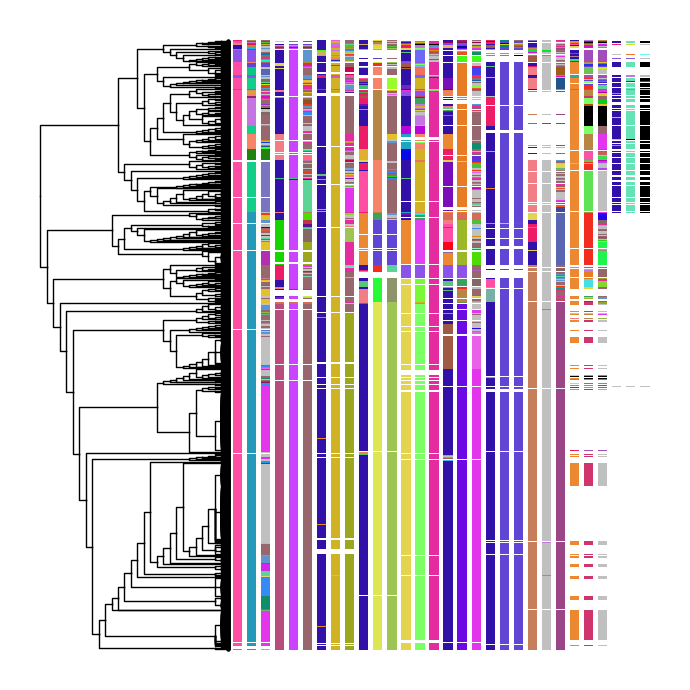

In [ ]:
greedy_solver.solve(tree)

cas.pl.plot_matplotlib(tree, orient="right", allele_table=tumor_allele_table)

In [ ]:
cas.tl.compute_expansion_pvalues(tree, min_clade_size=(0.15 * tree.n_cell), min_depth=1)

In [ ]:
# this specifies a p-value for identifying expansions unlikely to have occurred
# in a neutral model of evolution
probability_threshold = 0.01

expanding_nodes = []
for node in tree.depth_first_traverse_nodes():
    if tree.get_attribute(node, "expansion_pvalue") < probability_threshold:
        expanding_nodes.append(node)

(<Figure size 700x700 with 1 Axes>, <Axes: >)

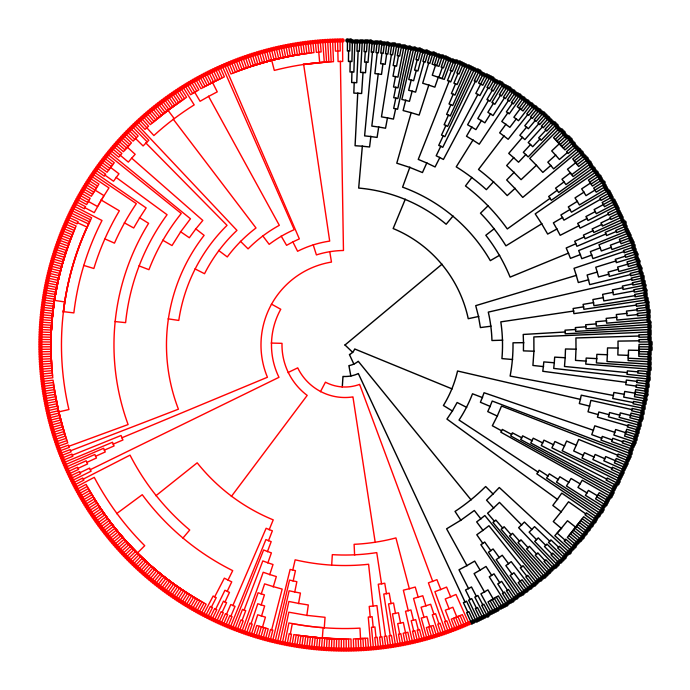

In [ ]:
cas.pl.plot_matplotlib(tree, clade_colors={expanding_nodes[6]: "red"})

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


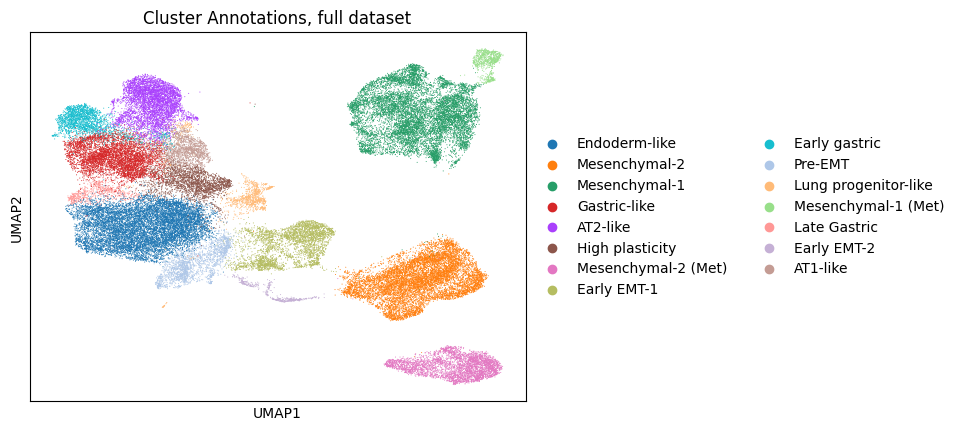

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


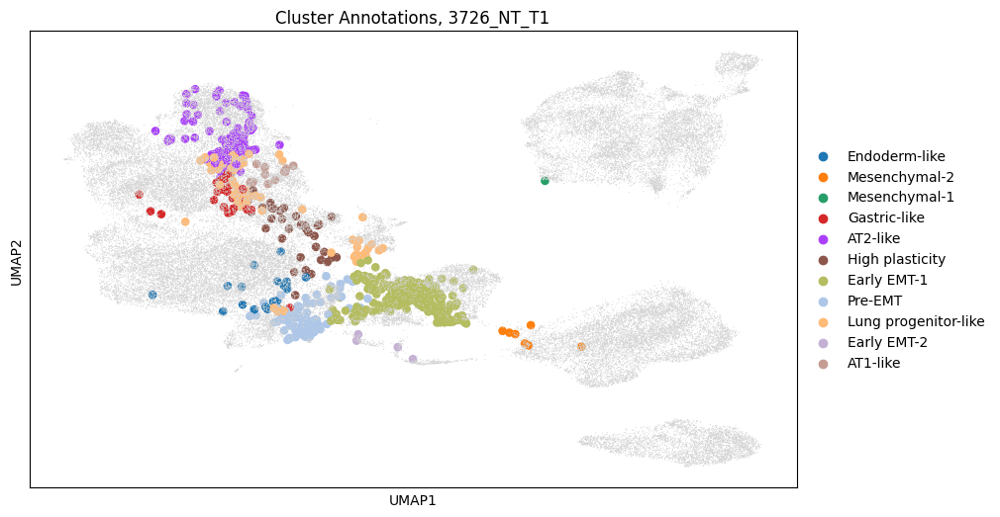

In [ ]:
kptracer_adata = sc.read_h5ad("KPTracer-Data/expression/adata_processed.nt.h5ad")
sc.pl.umap(
    kptracer_adata,
    color="Cluster-Name",
    show=False,
    title="Cluster Annotations, full dataset",
)
plt.show()

# plot only tumor of interest
fig = plt.figure(figsize=(10, 6))
ax = plt.gca()
sc.pl.umap(kptracer_adata[tree.leaves, :], color="Cluster-Name", show=False, ax=ax)
sc.pl.umap(
    kptracer_adata[np.setdiff1d(kptracer_adata.obs_names, tree.leaves), :],
    show=False,
    ax=ax,
    title=f"Cluster Annotations, {tumor}",
)
plt.show()

(<Figure size 700x700 with 1 Axes>, <Axes: >)

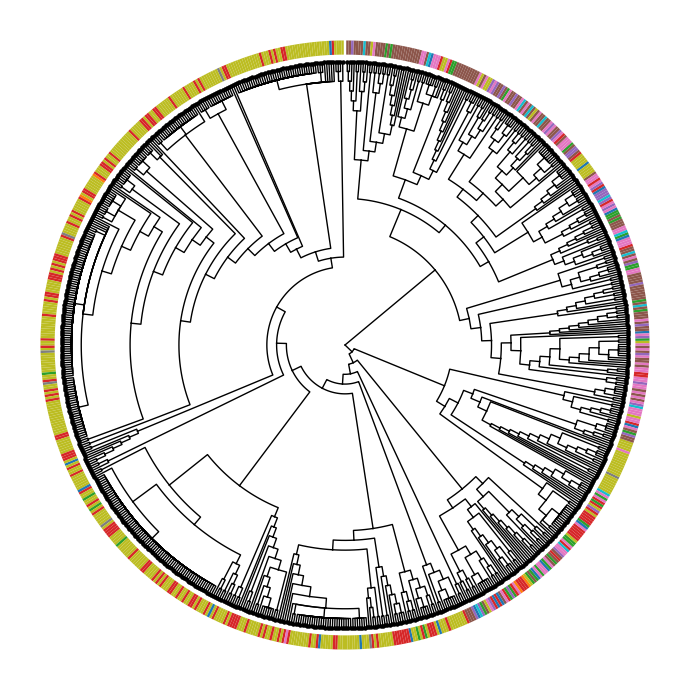

In [ ]:
tree.cell_meta = pd.DataFrame(
    kptracer_adata.obs.loc[tree.leaves, "Cluster-Name"].astype(str)
)

cas.pl.plot_matplotlib(tree, meta_data=["Cluster-Name"])

In [ ]:
parsimony = cas.tl.score_small_parsimony(tree, meta_item="Cluster-Name")

plasticity = parsimony / len(tree.nodes)

print(f"Observed effective plasticity score of {plasticity}.")

Observed effective plasticity score of 0.2356902356902357.


In [ ]:
# compute plasticities for each node in the tree
for node in tree.depth_first_traverse_nodes():
    effective_plasticity = cas.tl.score_small_parsimony(
        tree, meta_item="Cluster-Name", root=node
    )
    size_of_subtree = len(tree.leaves_in_subtree(node))
    tree.set_attribute(
        node, "effective_plasticity", effective_plasticity / size_of_subtree
    )

tree.cell_meta["scPlasticity"] = 0
for leaf in tree.leaves:
    plasticities = []
    parent = tree.parent(leaf)
    while True:
        plasticities.append(tree.get_attribute(parent, "effective_plasticity"))
        if parent == tree.root:
            break
        parent = tree.parent(parent)

    tree.cell_meta.loc[leaf, "scPlasticity"] = np.mean(plasticities)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


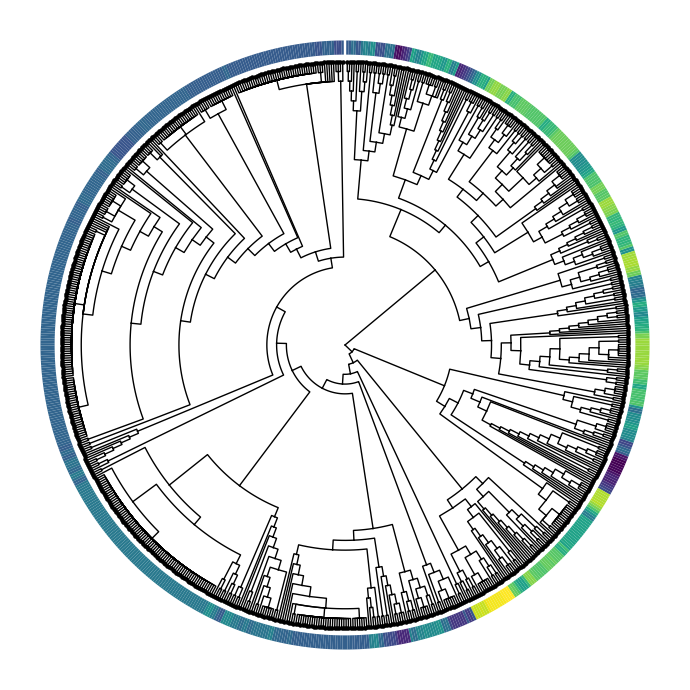

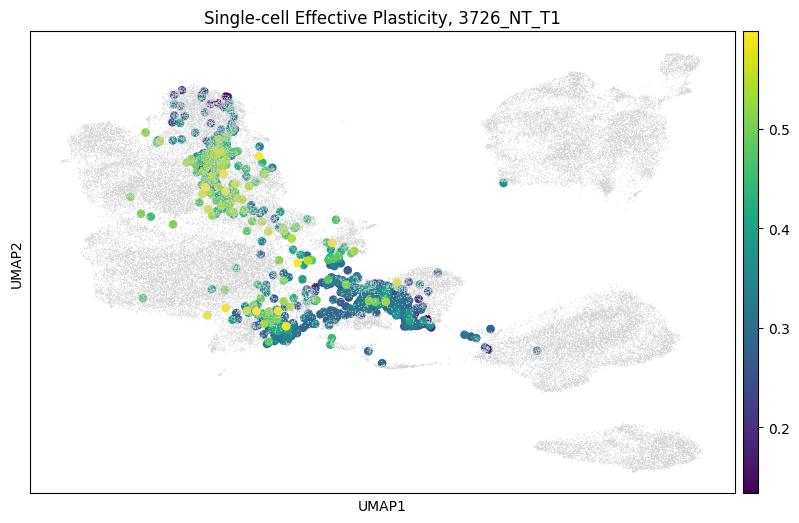

In [ ]:
cas.pl.plot_matplotlib(tree, meta_data=["scPlasticity"])

kptracer_adata.obs["scPlasticity"] = np.nan
kptracer_adata.obs.loc[tree.leaves, "scPlasticity"] = tree.cell_meta["scPlasticity"]

# plot only tumor of interest
fig = plt.figure(figsize=(10, 6))
ax = plt.gca()
sc.pl.umap(kptracer_adata[tree.leaves, :], color="scPlasticity", show=False, ax=ax)
sc.pl.umap(
    kptracer_adata[np.setdiff1d(kptracer_adata.obs_names, tree.leaves), :],
    show=False,
    ax=ax,
)
plt.title(f"Single-cell Effective Plasticity, {tumor}")
plt.show()